<a href="https://colab.research.google.com/github/AdepojuJeremy/AI/blob/master/Pruning_Strategies.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

###  A. Data collection
In this study, utilizing healthcare data for predictive modelling using calibrated methods, the dataset contains a range of variables related to individuals, demographics, health behaviors, and medical conditions. These variables collectively contribute to the understanding of overweight individuals and factors associated with their health. The healthcare data used in this study comes from healthcare institutions.

Demographics offer an essential starting point for comprehending the healthcare landscape. Variables such as 'AGEfinal,' 'Sex,' and 'Race' are instrumental in characterizing individuals. Age, gender, and ethnicity are intrinsic factors that significantly influence health dynamics. They serve as the foundational markers upon which subsequent analyses are built.

Socioeconomic factors contribute a critical layer to the healthcare narrative. 'hhinc2,' representing household income, and 'Healthcare_access2yr,' indicating access to healthcare services, shed light on the socioeconomic status of individuals. Socioeconomic factors often interplay with health behaviors and outcomes. An individual's financial situation and healthcare accessibility can act as determinants in shaping health decisions.

Health behaviors delineate the choices and habits that define an individual's lifestyle. The dataset encompasses variables such as 'Cursmoker' (reflecting current smoking status), 'physical_activity' (capturing exercise habits), 'snack_freq' (illuminating snacking routines), and 'weightloss_attempt' and 'weightgain_attempt' (highlighting endeavors to shed or gain weight). These behaviors are pivotal in understanding the factors contributing to overweight individuals' health trajectories.

Medical information is an indispensable category of variables that lends depth to healthcare analysis. 'SBPfinal' and 'DBPfinal' represent systolic and diastolic blood pressure, critical indicators of cardiovascular health. 'famhist_hbp,' 'famhist_diabetes,' and 'famhist_heartdis' denote family medical histories, offering insights into hereditary health conditions. 'Psych_dist2' may quantify psychological distress, a variable with far-reaching implications for overall well-being.

Diet and nutrition constitute fundamental aspects of health. Variables such as 'butterspread,' 'scores_sugar,' 'scores_fruit,' 'CategoricalFatScore1,' and 'NutriKnowA_cat' convey information about dietary choices and nutritional knowledge. These factors are intimately linked to weight management and can profoundly influence an individual's health trajectory.

Medication and medical conditions elucidate the medical context of the individuals in the dataset. 'medaid1' may signify reliance on Medicaid or similar medical assistance programs, providing insights into the utilization of healthcare resources. 'DDScat1' might pertain to dental health, an integral facet of overall well-being. 'overweight' is a pivotal variable, likely signifying whether individuals are classified as overweight or not, a central focus in this analysis.

Substance use, as indicated by 'AuditC3_MF1,' is an additional dimension in understanding health behaviors. This variable likely pertains to alcohol consumption, a substance with known impacts on health.

Lastly, geographical information embedded in 'geotype' and 'dwell_typ1' can provide context about individuals' living conditions and locations. These factors play a pertinent role in understanding health disparities, as environmental conditions often impact health outcomes.


### B. Feature selection and engineering
The field of disease diagnosis has benefited immensely from predictive modeling techniques. However, the efficacy of these models heavily relies on the quality of input features. Feature selection is a crucial process in which relevant features are chosen or engineered to improve the accuracy and interpretability of predictive models. In this research, we explore the application of the SelectKBest feature selection method with an ANOVA F-statistic (f_classif) score function, aiming to identify the top 10 features with the highest predictive power.

                                  selector = SelectKBest(score_func=f_classif, k=10)  # Select the top 10 features
X_selected = selector.fit_transform(X_scaled, y)


The code snippet provided illustrates the application of SelectKBest to the dataset (X_scaled) with the target variable (y). SelectKBest is a univariate feature selection method that selects the top k features based on a user-defined scoring function. In this case, fclassif is employed, which utilizes analysis of variance (ANOVA) F-statistics to score each feature's importance in relation to the target variable. The 'k' parameter is set to 10, indicating the selection of the top 10 features with the highest F-statistic scores.

Feature selection is an essential step in improving the accuracy of predictive modeling for disease diagnosis. The SelectKBest method with f_classif score function helps identify the most relevant features, reducing dimensionality and enhancing the model's performance. Additionally, calibration scaling techniques play a crucial role in ensuring the reliability of predictions. The comparative analysis in this research provides valuable insights into the optimal combination of feature selection and calibration scaling methods for disease diagnosis models.


### C. Model selection
 We focus on a single supervised classification algorithm and ten different pruning strategies in this work. This model was selected because it has been shown to outperform other supervised learning algorithms with respect to class probability estimation in the literature. The model considered, in line with the pruning strategies, is briefly described in this section. We consider the Decision trees algorithm and pruning strategies, including Reduced Error Pruning (R.E.P), Error Based Pruning (E.B.P), Minimum Sample Size Pruning (M.S.S.P), Minimum Gain Sampling Pruning (M.G.S.P), Complexity Parameter Pruning (C.P.P), Cross Validation Pruning (C.V.P), Rule-Post Pruning1, Pessimistic Pruning, Pre-Pruning(Early Stopping) and Simultaneous Pruning. More details about these models can be found in the cerebral work of Hastie et al. (2009)2.

### Decision Trees
A decision tree is an approach to break up a complex decision into multiple simpler decisions (Safavian and Landgrebe, 1991)3. This algorithm is one of the most successful data mining approaches. It has been widely employed in a variety of areas, and it is robust even when there are missing values in the dataset (Hastie et al., 2009)2. The algorithm collects observations of an object, represented by branches, and draws inferences about the problem goal value, represented by leaves. It may display the decisions in a tree-like structure. The tree is constructed by subdividing the target, which contains the tree’s root node as well as its successive children. The basic concept of decision trees is the fundamental components of the model, which are nodes and branches, and the most significant phases in developing the model are splitting, stopping, and pruning. The splitting of the trees is based on classification features splitting rules (Shalev-Shwartz and Ben-David, 2014)4. This algorithm is prone to high variance and overfitting of the imbalanced training data, which can be characterized by Entropy and Information Gain (Panigrahi et al., 2021)5. Entropy is a measure of randomness in a dataset. It is defined as:

In [ ]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn import metrics

import warnings
warnings.filterwarnings("ignore")

#check that the data loaded in is in the correct format
pd.set_option('display.max_columns', 500)

In [ ]:
df = pd.read_csv("odata.csv")

df.head()

,geotype,AGEfinal,Sex,Race,hhinc2,aindex_cat,dwell_typ1,medaid1,agric_animal1,Hunger_cat1,weightloss_attempt,weightgain_attempt,SBPfinal,DBPfinal,Cursmoker,Psych_dist2,butterspread,scores_sugar,scores_fruit,NutriKnowA_cat,DDScat1,CategoricalFatScore1,physical_activity,Healthcare_access2yr,famhist_hbp,famhist_diabetes,famhist_heartdis,redmeat_wfat,milkserv_daily,snack_freq,overweight,AuditC3_MF1
0,3,17,2,1,2,2,1,1,2,1,2,2,132,78,2,2,3,3,3,2,1,1,1,1,2,2,2,1,5,2,1,2
1,1,15,1,1,1,1,1,2,2,2,2,2,124,66,2,2,3,1,2,2,1,2,2,1,1,2,2,1,3,1,1,2
2,1,15,1,1,1,2,1,2,2,3,2,1,128,90,2,2,4,3,2,3,1,1,2,2,1,1,2,1,3,2,0,2
3,1,15,2,3,2,2,1,2,2,1,2,2,110,55,2,2,5,1,2,2,1,2,2,2,1,1,1,2,5,1,0,2
4,1,15,2,1,2,1,1,2,2,1,2,2,116,67,2,1,3,3,2,2,2,1,1,2,1,1,2,1,4,1,1,2


In [ ]:
df["overweight"].value_counts()

0    525
1    146
Name: overweight, dtype: int64

In [ ]:
#print the dimension of the dataset
print("The dataset contains %s rows and %s columns \n"%(df.shape[0],df.shape[1]))

# show the first 10 rows using dataframe.head() method
df.head(4)

The dataset contains 671 rows and 32 columns 



,geotype,AGEfinal,Sex,Race,hhinc2,aindex_cat,dwell_typ1,medaid1,agric_animal1,Hunger_cat1,weightloss_attempt,weightgain_attempt,SBPfinal,DBPfinal,Cursmoker,Psych_dist2,butterspread,scores_sugar,scores_fruit,NutriKnowA_cat,DDScat1,CategoricalFatScore1,physical_activity,Healthcare_access2yr,famhist_hbp,famhist_diabetes,famhist_heartdis,redmeat_wfat,milkserv_daily,snack_freq,overweight,AuditC3_MF1
0,3,17,2,1,2,2,1,1,2,1,2,2,132,78,2,2,3,3,3,2,1,1,1,1,2,2,2,1,5,2,1,2
1,1,15,1,1,1,1,1,2,2,2,2,2,124,66,2,2,3,1,2,2,1,2,2,1,1,2,2,1,3,1,1,2
2,1,15,1,1,1,2,1,2,2,3,2,1,128,90,2,2,4,3,2,3,1,1,2,2,1,1,2,1,3,2,0,2
3,1,15,2,3,2,2,1,2,2,1,2,2,110,55,2,2,5,1,2,2,1,2,2,2,1,1,1,2,5,1,0,2


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 671 entries, 0 to 670
Data columns (total 32 columns):
 #   Column                Non-Null Count  Dtype
---  ------                --------------  -----
 0   geotype               671 non-null    int64
 1   AGEfinal              671 non-null    int64
 2   Sex                   671 non-null    int64
 3   Race                  671 non-null    int64
 4   hhinc2                671 non-null    int64
 5   aindex_cat            671 non-null    int64
 6   dwell_typ1            671 non-null    int64
 7   medaid1               671 non-null    int64
 8   agric_animal1         671 non-null    int64
 9   Hunger_cat1           671 non-null    int64
 10  weightloss_attempt    671 non-null    int64
 11  weightgain_attempt    671 non-null    int64
 12  SBPfinal              671 non-null    int64
 13  DBPfinal              671 non-null    int64
 14  Cursmoker             671 non-null    int64
 15  Psych_dist2           671 non-null    int64
 16  buttersp

In [ ]:
#get the number of missing values in each column of the dataset
missing_count = df.isna().sum().sort_values(ascending=False)
print(missing_count)

geotype                 0
AGEfinal                0
overweight              0
snack_freq              0
milkserv_daily          0
redmeat_wfat            0
famhist_heartdis        0
famhist_diabetes        0
famhist_hbp             0
Healthcare_access2yr    0
physical_activity       0
CategoricalFatScore1    0
DDScat1                 0
NutriKnowA_cat          0
scores_fruit            0
scores_sugar            0
butterspread            0
Psych_dist2             0
Cursmoker               0
DBPfinal                0
SBPfinal                0
weightgain_attempt      0
weightloss_attempt      0
Hunger_cat1             0
agric_animal1           0
medaid1                 0
dwell_typ1              0
aindex_cat              0
hhinc2                  0
Race                    0
Sex                     0
AuditC3_MF1             0
dtype: int64


In [ ]:
# check for duplicate records

df.duplicated().sum()

0

In [ ]:
df.describe().T  #T transposes the resulting dataframe

,count,mean,std,min,25%,50%,75%,max
geotype,671.0,2.156483,1.122743,1.0,1.0,2.0,3.0,4.0
AGEfinal,671.0,16.004471,0.854301,15.0,15.0,16.0,17.0,17.0
Sex,671.0,1.558867,0.496893,1.0,1.0,2.0,2.0,2.0
Race,671.0,1.529061,0.924931,1.0,1.0,1.0,2.0,4.0
hhinc2,671.0,2.183308,1.039843,1.0,1.0,2.0,3.0,4.0
aindex_cat,671.0,1.591654,0.757168,1.0,1.0,1.0,2.0,4.0
dwell_typ1,671.0,1.204173,0.403397,1.0,1.0,1.0,1.0,2.0
medaid1,671.0,1.885246,0.318963,1.0,2.0,2.0,2.0,2.0
agric_animal1,671.0,1.941878,0.234149,1.0,2.0,2.0,2.0,2.0
Hunger_cat1,671.0,2.010432,0.878369,1.0,1.0,2.0,3.0,3.0


(0.0, 100.0)

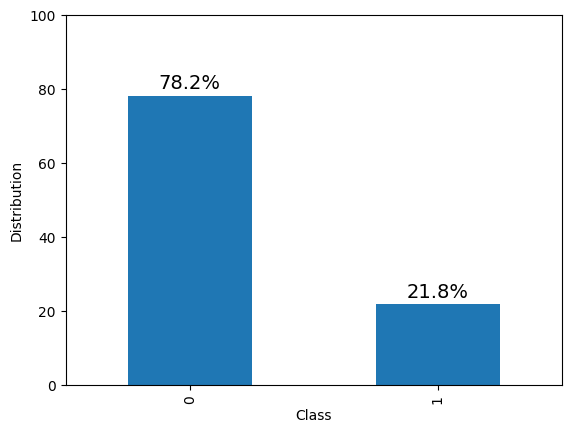

In [ ]:
#To check our target variable

ax = df["overweight"].value_counts(normalize=True).mul(100).plot.bar()
for p in ax.patches:
    y = p.get_height()
    x = p.get_x() + p.get_width() / 2

    # Label of bar height
    label = "{:.1f}%".format(y)

    # Annotate plot
    ax.annotate(label, xy=(x, y), xytext=(0, 5), textcoords="offset points", ha="center", fontsize=14)

# Add x and y axis titles
ax.set_xlabel("Class")
ax.set_ylabel("Distribution")
ax.set_ylim(0,100)

# Remove y axis
#ax.get_yaxis().set_visible(False)

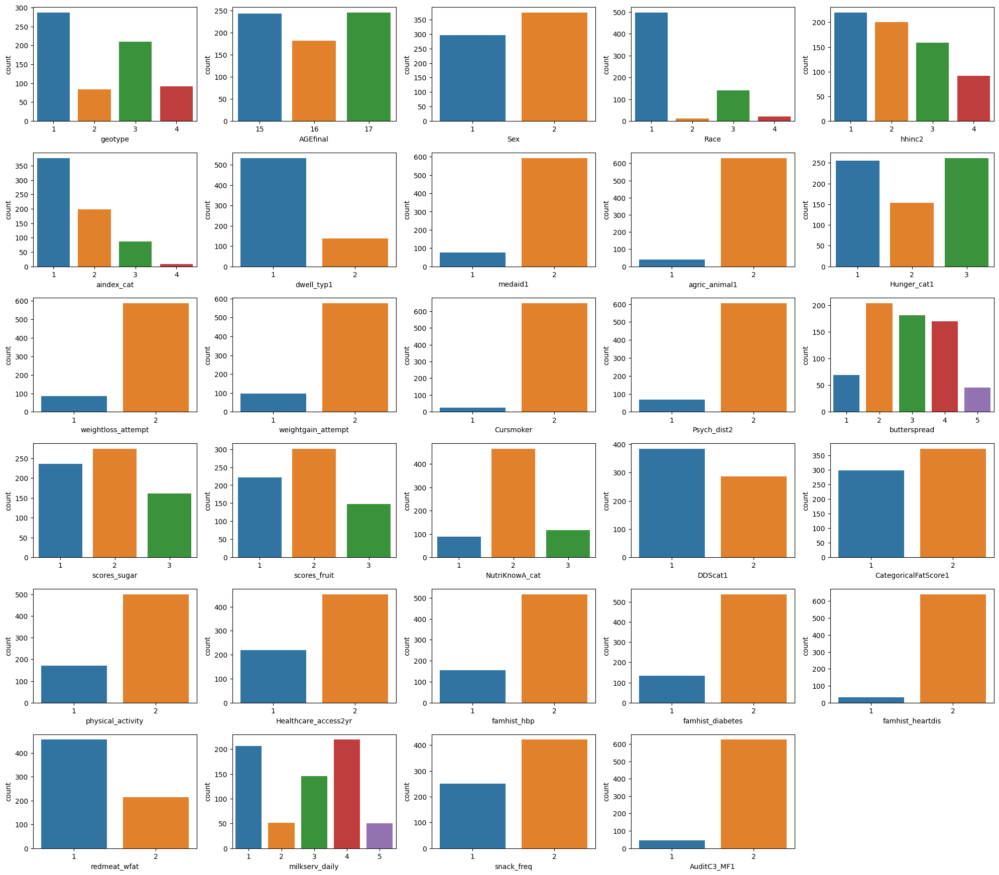

In [ ]:
fig = plt.figure(figsize=(20,20))

for i, col in enumerate(df.drop(columns=["overweight", "DBPfinal", "SBPfinal"], axis =1).columns.to_list()):
    ax1 = fig.add_subplot(7, 5, i+1)
    sns.countplot(x=col, data=df, ax=ax1)

plt.tight_layout()

fig.savefig('univariate_plots.jpeg')
plt.show()

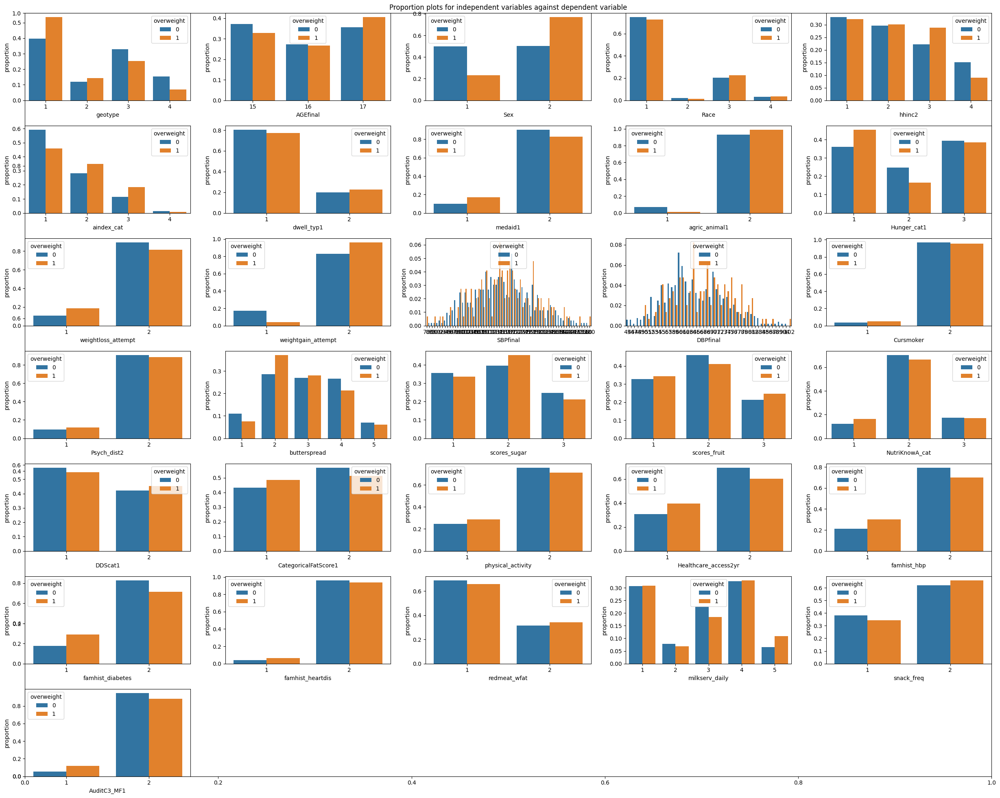

In [ ]:
fig = plt.figure(figsize=(25,20))

plt.title("Proportion plots for independent variables against dependent variable")

for i, col in enumerate(df.drop(columns="overweight").columns.to_list()):
    ax1 = fig.add_subplot(7, 5, i+1)
    x, y, hue = col, "proportion", "overweight"
    (df[x]
     .groupby(df[hue])
     .value_counts(normalize=True)
     .rename(y)
     .reset_index()
     .pipe((sns.barplot, "data"), x=x, y=y, hue=hue, ax=ax1))

plt.tight_layout()
fig.savefig('bivariate.jpeg')
plt.show()

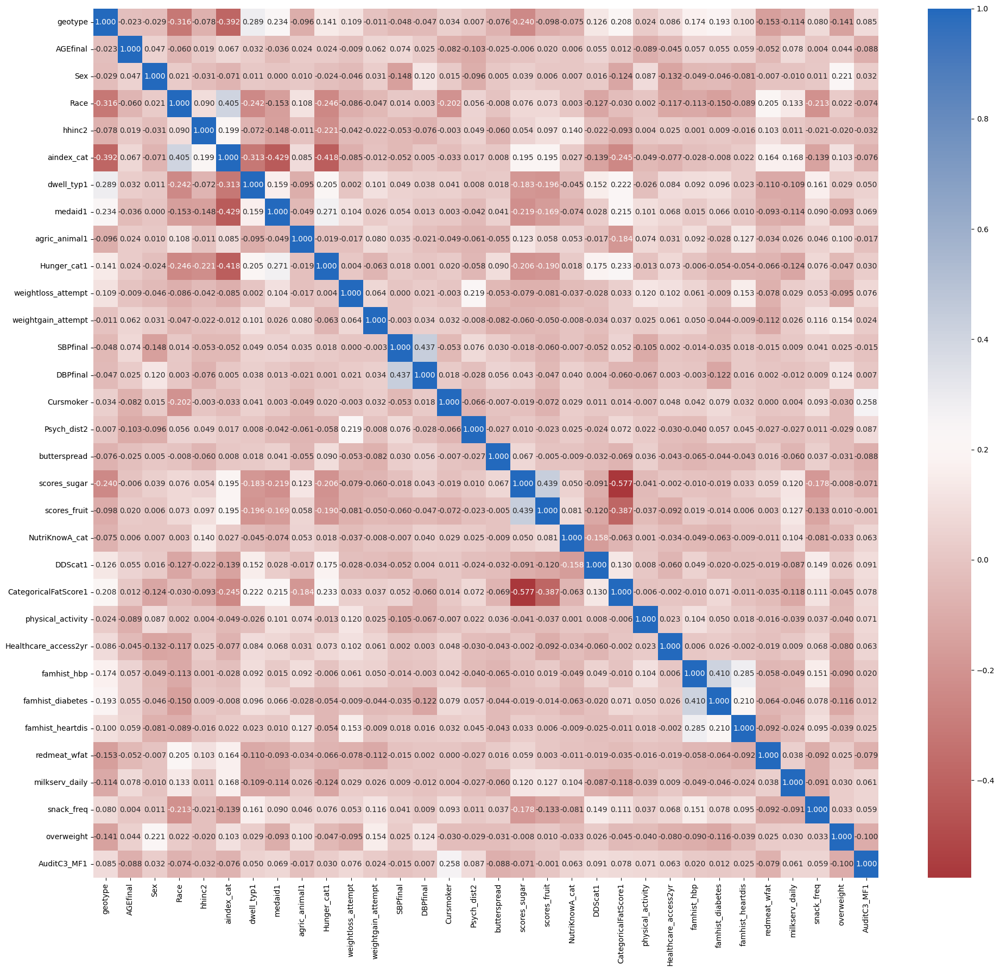

In [ ]:
# correlation plot
plt.figure(figsize = [20, 18])
sns.heatmap(df.corr(), annot = True, fmt = '.3f',
           cmap = 'vlag_r')
plt.tight_layout()
plt.savefig('multi.jpeg') # save the plot
plt.show()

In [ ]:
# Let’s create a copy so we can play with it without harming the original dataset
clean_df = df.copy()

clean_df.head(n=4)

,geotype,AGEfinal,Sex,Race,hhinc2,aindex_cat,dwell_typ1,medaid1,agric_animal1,Hunger_cat1,weightloss_attempt,weightgain_attempt,SBPfinal,DBPfinal,Cursmoker,Psych_dist2,butterspread,scores_sugar,scores_fruit,NutriKnowA_cat,DDScat1,CategoricalFatScore1,physical_activity,Healthcare_access2yr,famhist_hbp,famhist_diabetes,famhist_heartdis,redmeat_wfat,milkserv_daily,snack_freq,overweight,AuditC3_MF1
0,3,17,2,1,2,2,1,1,2,1,2,2,132,78,2,2,3,3,3,2,1,1,1,1,2,2,2,1,5,2,1,2
1,1,15,1,1,1,1,1,2,2,2,2,2,124,66,2,2,3,1,2,2,1,2,2,1,1,2,2,1,3,1,1,2
2,1,15,1,1,1,2,1,2,2,3,2,1,128,90,2,2,4,3,2,3,1,1,2,2,1,1,2,1,3,2,0,2
3,1,15,2,3,2,2,1,2,2,1,2,2,110,55,2,2,5,1,2,2,1,2,2,2,1,1,1,2,5,1,0,2


In [ ]:
X = df.drop(["overweight"], axis = 1)
y = df["overweight"]

In [ ]:
from imblearn.over_sampling import SMOTE

sm = SMOTE(random_state=42)
X, y = sm.fit_resample(X, y)

In [ ]:
y.value_counts()

1    525
0    525
Name: overweight, dtype: int64

(0.0, 60.0)

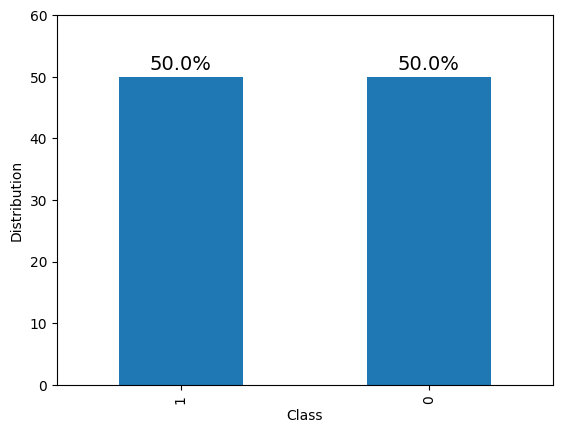

In [ ]:
#To check our target variable

ax = y.value_counts(normalize=True).mul(100).plot.bar()
for p in ax.patches:
    y_h = p.get_height()
    x = p.get_x() + p.get_width() / 2

    # Label of bar height
    label = "{:.1f}%".format(y_h)

    # Annotate plot
    ax.annotate(label, xy=(x, y_h), xytext=(0, 5), textcoords="offset points", ha="center", fontsize=14)

# Add x and y axis titles
ax.set_xlabel("Class")
ax.set_ylabel("Distribution")
ax.set_ylim(0,60)

# Remove y axis
#ax.get_yaxis().set_visible(False)

In [ ]:
from sklearn.model_selection import train_test_split
X_train,X_test,y_train,y_test = train_test_split(X,y,random_state=42, stratify = y, test_size = 0.3)

In [ ]:
X_test.shape

(315, 31)

In [ ]:
from sklearn.preprocessing import StandardScaler

# Make a copy of X_train
X_train_scaled = X_train.copy()

# Make a copy of X_test
X_test_scaled = X_test.copy()

# Initialize StandardScaler
scaler = StandardScaler()

# Fit the scaler to the X_train data
scaler.fit(X_train)

# Transform X_train and assign scaled values to X_train_scaled
X_train_scaled[X_train.columns] = scaler.transform(X_train)

# Transform X_test using the parameters learned from X_train
X_test_scaled[X_test.columns] = scaler.transform(X_test)

In [ ]:
X_test_scaled.head()

,geotype,AGEfinal,Sex,Race,hhinc2,aindex_cat,dwell_typ1,medaid1,agric_animal1,Hunger_cat1,weightloss_attempt,weightgain_attempt,SBPfinal,DBPfinal,Cursmoker,Psych_dist2,butterspread,scores_sugar,scores_fruit,NutriKnowA_cat,DDScat1,CategoricalFatScore1,physical_activity,Healthcare_access2yr,famhist_hbp,famhist_diabetes,famhist_heartdis,redmeat_wfat,milkserv_daily,snack_freq,AuditC3_MF1
903,-0.922374,0.088389,0.842201,-0.544857,-1.057376,0.667904,-0.42623,0.463547,0.209843,-1.040998,0.487210,0.382944,-1.225064,-0.202264,0.220232,0.417279,0.263020,0.318051,1.739178,0.108110,1.422916,-0.863622,0.689858,-1.151499,0.713611,0.666339,0.281594,-0.561113,-1.310211,0.887875,0.339597
1016,-0.922374,1.314162,0.842201,-0.544857,2.022563,-0.750909,-0.42623,0.463547,0.209843,0.116541,0.487210,0.382944,0.055878,-0.554827,0.220232,0.417279,-0.694009,1.701293,1.739178,0.108110,-0.702782,-0.863622,-1.449574,-1.151499,-1.401324,-1.500737,0.281594,-0.561113,0.975402,-1.126285,0.339597
944,-0.922374,-1.137384,-1.187365,3.020156,0.995917,2.086717,-0.42623,-2.157277,0.209843,-1.040998,-2.052502,0.382944,0.296054,-0.084743,0.220232,0.417279,-1.651039,-1.065190,0.328255,1.914034,-0.702782,1.157914,-1.449574,0.868433,-1.401324,0.666339,0.281594,1.782172,0.975402,-1.126285,0.339597
801,-0.922374,-1.137384,0.842201,-0.544857,-1.057376,-0.750909,-0.42623,0.463547,0.209843,0.116541,0.487210,0.382944,-1.305123,-1.024910,0.220232,0.417279,0.263020,0.318051,-1.082667,0.108110,-0.702782,-0.863622,-1.449574,0.868433,-1.401324,-1.500737,-3.551213,-0.561113,-1.310211,0.887875,0.339597
87,-0.922374,1.314162,-1.187365,-0.544857,0.995917,-0.750909,-0.42623,0.463547,0.209843,0.116541,0.487210,0.382944,2.057349,1.090466,0.220232,0.417279,0.263020,1.701293,-1.082667,0.108110,-0.702782,1.157914,-1.449574,0.868433,-1.401324,-1.500737,0.281594,-0.561113,0.975402,-1.126285,0.339597


In [ ]:
from sklearn.metrics import matthews_corrcoef
from sklearn.metrics import balanced_accuracy_score
from sklearn.metrics import cohen_kappa_score
from sklearn.metrics import roc_curve, roc_auc_score
from sklearn.metrics import  ConfusionMatrixDisplay

In [ ]:
all_scores_dict = {} # scores for all models

### PRUNING STRATEGIES

#### 1. Reduced Error Pruning. (R.E.P)

In [ ]:
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score

# Load your dataset and split it into training and testing sets
#X_train, X_test, y_train, y_test = train_test_split(X, y, random_state=42, stratify=y, test_size=0.3)

# Train an initial decision tree without pruning
initial_tree = DecisionTreeClassifier(random_state=42)
initial_tree.fit(X_train_scaled, y_train)

# Function for Reduced Error Pruning
def reduced_error_pruning(tree, X_val, y_val):
    leaf_nodes = set(tree.apply(X_val))

    for node in leaf_nodes:
        if tree.tree_.children_left[node] != tree.tree_.children_right[node]:
            # Make a copy of the tree
            pruned_tree = DecisionTreeClassifier(random_state=42)
            pruned_tree.tree_ = tree.tree_.copy()

            # Prune the subtree
            pruned_tree.tree_.children_left[node] = pruned_tree.tree_.children_right[node] = -1

            # Make predictions on the validation set
            y_pred = pruned_tree.predict(X_val)

            # Calculate the accuracy of the tree on the validation set
            initial_accuracy = accuracy_score(y_val, y_pred)

            # Calculate the accuracy after pruning
            y_pred = tree.predict(X_val)
            pruned_accuracy = accuracy_score(y_val, y_pred)

            # Compare accuracy before and after pruning
            if pruned_accuracy >= initial_accuracy:
                tree.tree_ = pruned_tree.tree_

# Apply Reduced Error Pruning
reduced_error_pruning(initial_tree, X_test_scaled, y_test)



# Evaluate the pruned tree on the test set
y_pred = initial_tree.predict(X_test_scaled)
pruned_accuracy = accuracy_score(y_test, y_pred)

print("Accuracy after Reduced Error Pruning:", pruned_accuracy)


Accuracy after Reduced Error Pruning: 0.726984126984127


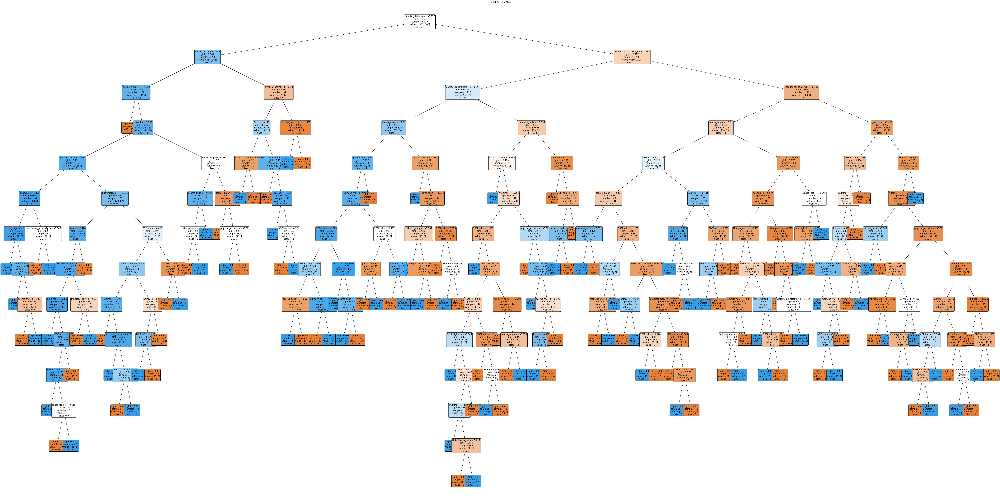

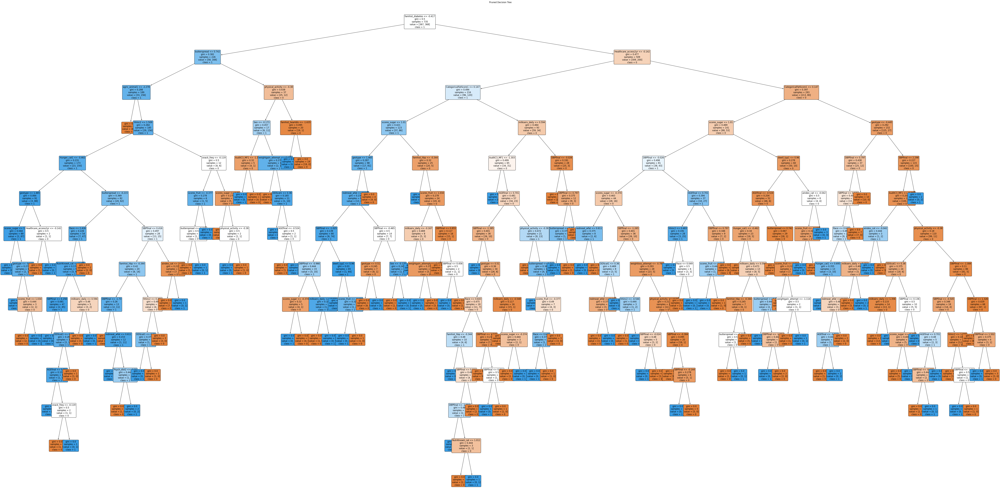

Accuracy before Reduced Error Pruning: 0.727
Accuracy after Reduced Error Pruning: 0.727


In [ ]:
from sklearn.tree import DecisionTreeClassifier, plot_tree
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score
import matplotlib.pyplot as plt

# Load your dataset and split it into training and testing sets
# X_train, X_test, y_train, y_test = train_test_split(X, y, random_state=42, stratify=y, test_size=0.3)

# Train an initial decision tree without pruning
initial_tree = DecisionTreeClassifier(random_state=42)
initial_tree.fit(X_train_scaled, y_train)

# Function for Reduced Error Pruning
def reduced_error_pruning(tree, X_val, y_val):
    leaf_nodes = set(tree.apply(X_val))

    for node in leaf_nodes:
        if tree.tree_.children_left[node] != tree.tree_.children_right[node]:
            # Make a copy of the tree
            pruned_tree = DecisionTreeClassifier(random_state=42)
            pruned_tree.tree_ = tree.tree_.copy()

            # Prune the subtree
            pruned_tree.tree_.children_left[node] = pruned_tree.tree_.children_right[node] = -1

            # Make predictions on the validation set
            y_pred = pruned_tree.predict(X_val)

            # Calculate the accuracy of the tree on the validation set
            initial_accuracy = accuracy_score(y_val, y_pred)

            # Calculate the accuracy after pruning
            y_pred = tree.predict(X_val)
            pruned_accuracy = accuracy_score(y_val, y_pred)

            # Compare accuracy before and after pruning
            if pruned_accuracy >= initial_accuracy:
                tree.tree_ = pruned_tree.tree_

# Evaluate the initial tree on the test set
y_pred_initial = initial_tree.predict(X_test_scaled)
initial_accuracy = accuracy_score(y_test, y_pred_initial)

# Plot the initial decision tree diagram
plt.figure(figsize=(100, 50))
plot_tree(initial_tree, filled=True, feature_names=X_train_scaled.columns, class_names=np.unique(y_train.astype(str)), rounded=True, fontsize=12)
plt.title("Initial Decision Tree")
plt.show()

# Apply Reduced Error Pruning
reduced_error_pruning(initial_tree, X_test_scaled, y_test)

# Plot the pruned decision tree diagram
plt.figure(figsize=(100, 50))
plot_tree(initial_tree, filled=True, feature_names=X_train_scaled.columns, class_names=np.unique(y_train.astype(str)), rounded=True, fontsize=12)
plt.title("Pruned Decision Tree")
plt.show()

# Evaluate the pruned tree on the test set
y_pred_pruned = initial_tree.predict(X_test_scaled)
pruned_accuracy = accuracy_score(y_test, y_pred_pruned)

print(f"Accuracy before Reduced Error Pruning: {initial_accuracy:.3f}")
print(f"Accuracy after Reduced Error Pruning: {pruned_accuracy:.3f}")


#### 2. ERROR BASED PRUNING.

In [ ]:
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score
from sklearn.tree import DecisionTreeClassifier

# Split the data into training and testing sets
#X_train, X_test, y_train, y_test = train_test_split(X, y, random_state=42, stratify=y, test_size=0.3)

# Train an initial decision tree without pruning using the training data
initial_tree = DecisionTreeClassifier(random_state=42)
initial_tree.fit(X_train_scaled, y_train)

# Function to calculate the error rate of a node
def calculate_node_error(y_val, node_indices):
    if len(node_indices) == 0:
        return 0.0
    majority_class = np.bincount(y_val[node_indices]).argmax()
    error_rate = 1.0 - accuracy_score(y_val[node_indices], [majority_class] * len(node_indices))
    return error_rate

# Function for Error-Based Pruning
def error_based_pruning(tree, error_threshold):
    # Recursive function to prune the tree
    def prune_tree(node):
        if tree.tree_.children_left[node] == tree.tree_.children_right[node]:  # Leaf node
            return

        left_child = tree.tree_.children_left[node]
        right_child = tree.tree_.children_right[node]

        # Calculate the error rates based on the training data
        left_indices = np.where(tree.apply(X_train_scaled) == left_child)[0]
        right_indices = np.where(tree.apply(X_train_scaled) == right_child)[0]

        left_error = calculate_node_error(y_train, left_indices)
        right_error = calculate_node_error(y_train, right_indices)

        if left_error <= error_threshold:
            tree.tree_.children_left[node] = left_child  # Prune left subtree
        else:
            prune_tree(left_child)

        if right_error <= error_threshold:
            tree.tree_.children_right[node] = right_child  # Prune right subtree
        else:
            prune_tree(right_child)

    prune_tree(0)  # Start pruning from the root

# Set the error threshold (adjust this value as needed)
error_threshold = 0.2

# Apply Error-Based Pruning using the initial_tree
error_based_pruning(initial_tree, error_threshold)

# Evaluate the pruned tree on the testing data
y_pred = initial_tree.predict(X_test_scaled)
accuracy = accuracy_score(y_test, y_pred)
print(f"Accuracy on the testing data after pruning: {accuracy:.3f}")


Accuracy on the testing data after pruning: 0.727


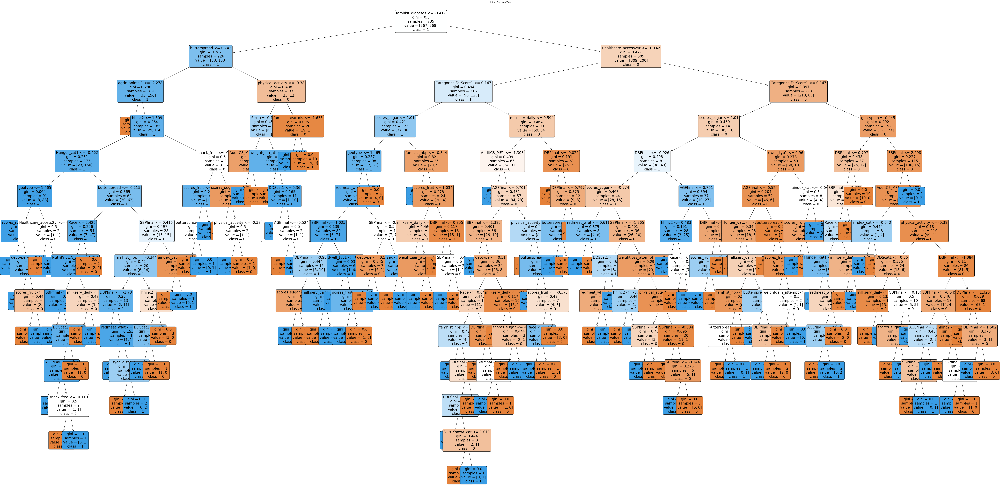

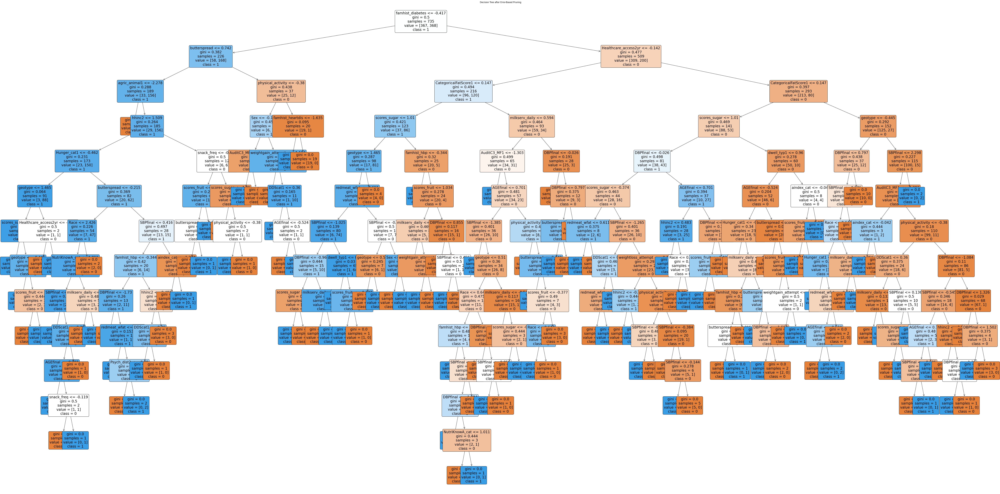

Initial Accuracy before pruning: 0.727
Accuracy on the testing data after pruning: 0.727


In [ ]:
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score
from sklearn.tree import DecisionTreeClassifier, plot_tree
import matplotlib.pyplot as plt

# Assuming X_train_scaled, y_train, X_test_scaled, y_test are defined earlier

# Split the data into training and testing sets
# X_train, X_test, y_train, y_test = train_test_split(X, y, random_state=42, stratify=y, test_size=0.3)

# Train an initial decision tree without pruning using the training data
initial_tree = DecisionTreeClassifier(random_state=42)
initial_tree.fit(X_train_scaled, y_train)

# Function to calculate the error rate of a node
def calculate_node_error(y_val, node_indices):
    if len(node_indices) == 0:
        return 0.0
    majority_class = np.bincount(y_val[node_indices]).argmax()
    error_rate = 1.0 - accuracy_score(y_val[node_indices], [majority_class] * len(node_indices))
    return error_rate

# Function for Error-Based Pruning
def error_based_pruning(tree, error_threshold):
    # Recursive function to prune the tree
    def prune_tree(node):
        if tree.tree_.children_left[node] == tree.tree_.children_right[node]:  # Leaf node
            return

        left_child = tree.tree_.children_left[node]
        right_child = tree.tree_.children_right[node]

        # Calculate the error rates based on the training data
        left_indices = np.where(tree.apply(X_train_scaled) == left_child)[0]
        right_indices = np.where(tree.apply(X_train_scaled) == right_child)[0]

        left_error = calculate_node_error(y_train, left_indices)
        right_error = calculate_node_error(y_train, right_indices)

        if left_error <= error_threshold:
            tree.tree_.children_left[node] = left_child  # Prune left subtree
        else:
            prune_tree(left_child)

        if right_error <= error_threshold:
            tree.tree_.children_right[node] = right_child  # Prune right subtree
        else:
            prune_tree(right_child)

    prune_tree(0)  # Start pruning from the root

# Set the error threshold (adjust this value as needed)
error_threshold = 0.3

# Apply Error-Based Pruning using the initial_tree
error_based_pruning(initial_tree, error_threshold)

# Visualize the initial decision tree
plt.figure(figsize=(100, 50))
plot_tree(initial_tree, filled=True, feature_names=X_train_scaled.columns, class_names=np.unique(y_train.astype(str)), rounded=True, fontsize=20)
plt.title("Initial Decision Tree")
plt.show()

# Visualize the pruned decision tree
plt.figure(figsize=(100, 50))
plot_tree(initial_tree, filled=True, feature_names=X_train_scaled.columns, class_names=np.unique(y_train.astype(str)), rounded=True, fontsize=20)
plt.title("Decision Tree after Error-Based Pruning")
plt.show()

# Evaluate the pruned tree on the testing data
y_pred = initial_tree.predict(X_test_scaled)
accuracy = accuracy_score(y_test, y_pred)
print(f"Initial Accuracy before pruning: {accuracy_score(y_test, initial_tree.predict(X_test_scaled)):.3f}")
print(f"Accuracy on the testing data after pruning: {accuracy:.3f}")


#### 3. MINIMUM SAMPLE SIZE PRUNING.

In [ ]:
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score

# Load your dataset and split it into training and testing sets
#X_train, X_test, y_train, y_test = train_test_split(X, y, random_state=42, stratify=y, test_size=0.3)

# Train an initial decision tree without pruning
initial_tree = DecisionTreeClassifier(random_state=42)
initial_tree.fit(X_train_scaled, y_train)

# Function for Minimum Sample Size Pruning
def minimum_sample_size_pruning(tree, X_val, y_val, min_samples):
    def prune_tree(node_index):
        if tree.tree_.n_node_samples[node_index] < min_samples:
            # Prune the subtree below this node
            tree.tree_.children_left[node_index] = -1
            tree.tree_.children_right[node_index] = -1
        else:
            # Recursively prune the left and right subtrees
            if tree.tree_.children_left[node_index] != -1:
                prune_tree(tree.tree_.children_left[node_index])
            if tree.tree_.children_right[node_index] != -1:
                prune_tree(tree.tree_.children_right[node_index])

    # Start pruning from the root
    prune_tree(0)

    return tree

# Set the minimum sample size threshold (adjust this value as needed)
min_samples = 10

# Apply Minimum Sample Size Pruning
pruned_tree = minimum_sample_size_pruning(initial_tree, X_test_scaled, y_test, min_samples)

# Evaluate the pruned tree on the test set
y_pred = pruned_tree.predict(X_test_scaled)
pruned_accuracy = accuracy_score(y_test, y_pred)

print("Accuracy after Minimum Sample Size Pruning:", pruned_accuracy)


Accuracy after Minimum Sample Size Pruning: 0.7174603174603175


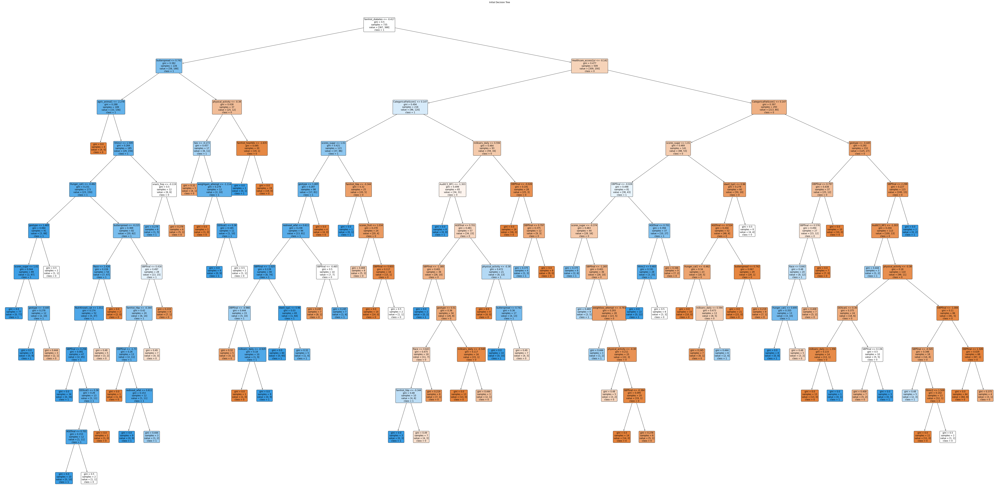

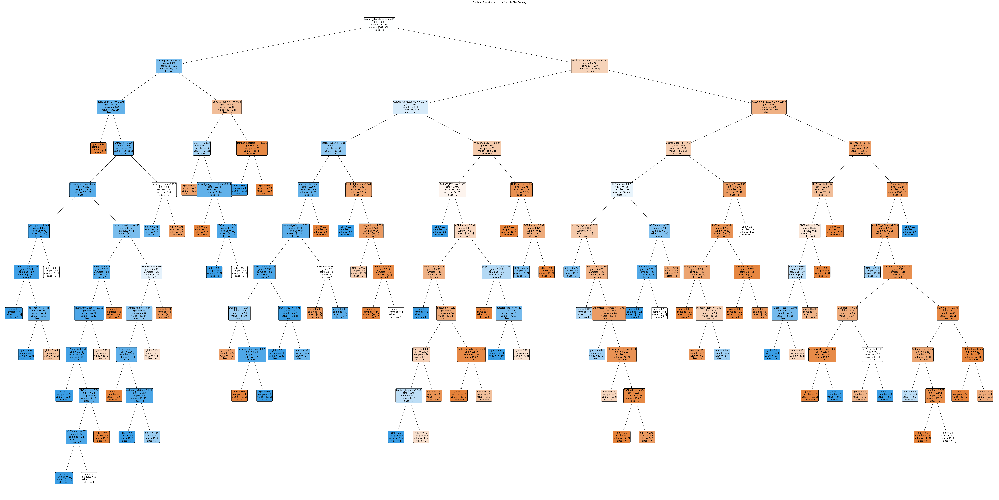

Initial Accuracy before pruning: 0.7174603174603175
Accuracy after Minimum Sample Size Pruning: 0.7174603174603175


In [ ]:
from sklearn.tree import DecisionTreeClassifier, plot_tree
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score
import matplotlib.pyplot as plt

# Load your dataset and split it into training and testing sets
# X_train, X_test, y_train, y_test = train_test_split(X, y, random_state=42, stratify=y, test_size=0.3)

# Train an initial decision tree without pruning
initial_tree = DecisionTreeClassifier(random_state=42)
initial_tree.fit(X_train_scaled, y_train)

# Function for Minimum Sample Size Pruning
def minimum_sample_size_pruning(tree, X_val, y_val, min_samples):
    def prune_tree(node_index):
        if tree.tree_.n_node_samples[node_index] < min_samples:
            # Prune the subtree below this node
            tree.tree_.children_left[node_index] = -1
            tree.tree_.children_right[node_index] = -1
        else:
            # Recursively prune the left and right subtrees
            if tree.tree_.children_left[node_index] != -1:
                prune_tree(tree.tree_.children_left[node_index])
            if tree.tree_.children_right[node_index] != -1:
                prune_tree(tree.tree_.children_right[node_index])

    # Start pruning from the root
    prune_tree(0)

    return tree

# Set the minimum sample size threshold (adjust this value as needed)
min_samples = 10

# Apply Minimum Sample Size Pruning
pruned_tree = minimum_sample_size_pruning(initial_tree, X_test_scaled, y_test, min_samples)

# Visualize the initial decision tree
plt.figure(figsize=(100, 50))
plot_tree(initial_tree, filled=True, feature_names=X_train_scaled.columns, class_names=np.unique(y_train.astype(str)), rounded=True, fontsize=12)
plt.title("Initial Decision Tree")
plt.show()

# Visualize the pruned decision tree
plt.figure(figsize=(100, 50))
plot_tree(pruned_tree, filled=True, feature_names=X_train_scaled.columns, class_names=np.unique(y_train.astype(str)), rounded=True, fontsize=12)
plt.title("Decision Tree after Minimum Sample Size Pruning")
plt.show()

# Evaluate the pruned tree on the test set
y_pred = pruned_tree.predict(X_test_scaled)
pruned_accuracy = accuracy_score(y_test, y_pred)

print("Initial Accuracy before pruning:", accuracy_score(y_test, initial_tree.predict(X_test_scaled)))
print("Accuracy after Minimum Sample Size Pruning:", pruned_accuracy)


#### 4. MIMIMUM GAIN PRUNING.

In [ ]:
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score

# Load your dataset and split it into training and testing sets
#X_train, X_test, y_train, y_test = train_test_split(X, y, random_state=42, stratify=y, test_size=0.3)

# Train an initial decision tree without pruning
initial_tree = DecisionTreeClassifier(random_state=42)
initial_tree.fit(X_train_scaled, y_train)

# Function for Minimum Gain Pruning
def minimum_gain_pruning(tree, X_val, y_val, min_impurity_decrease):
    # Prune nodes with impurity decrease less than the threshold
    pruned_tree = DecisionTreeClassifier(random_state=42, ccp_alpha=min_impurity_decrease)
    pruned_tree.fit(X_val, y_val)

    return pruned_tree

# Set the minimum impurity decrease threshold (adjust this value as needed)
min_impurity_decrease = 0.01

# Apply Minimum Gain Pruning
pruned_tree = minimum_gain_pruning(initial_tree, X_test_scaled, y_test, min_impurity_decrease)

# Evaluate the pruned tree on the test set
y_pred = pruned_tree.predict(X_test_scaled)
pruned_accuracy = accuracy_score(y_test, y_pred)

print("Accuracy after Minimum Gain Pruning:", pruned_accuracy)


Accuracy after Minimum Gain Pruning: 0.8634920634920635


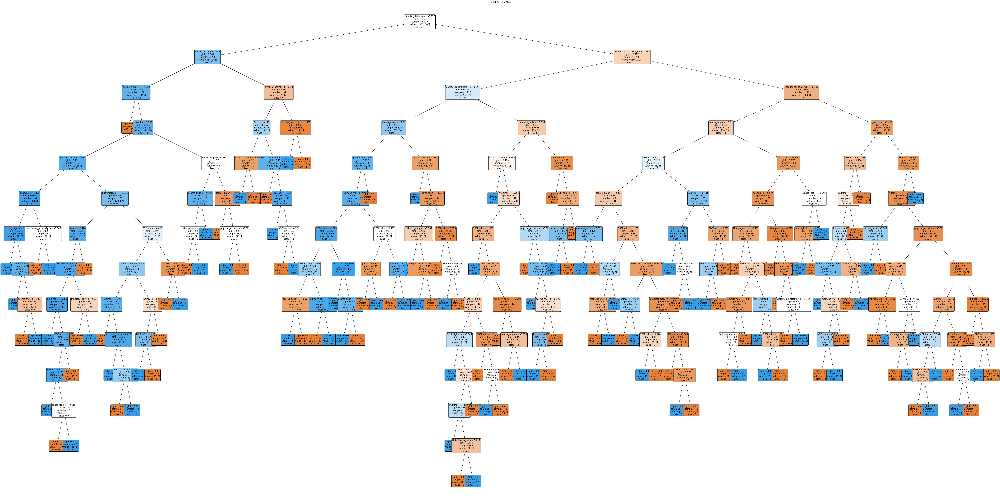

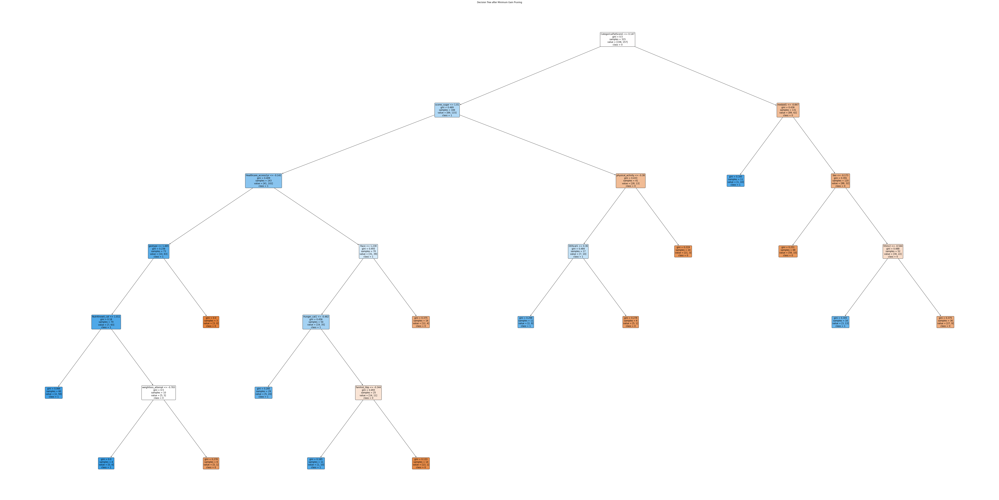

Initial Accuracy before pruning: 0.726984126984127
Accuracy after Minimum Gain Pruning: 0.8634920634920635


In [ ]:
from sklearn.tree import DecisionTreeClassifier, plot_tree
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score
import matplotlib.pyplot as plt

# Load your dataset and split it into training and testing sets
# X_train, X_test, y_train, y_test = train_test_split(X, y, random_state=42, stratify=y, test_size=0.3)

# Train an initial decision tree without pruning
initial_tree = DecisionTreeClassifier(random_state=42)
initial_tree.fit(X_train_scaled, y_train)

# Function for Minimum Gain Pruning
def minimum_gain_pruning(tree, X_val, y_val, min_impurity_decrease):
    # Prune nodes with impurity decrease less than the threshold
    pruned_tree = DecisionTreeClassifier(random_state=42, ccp_alpha=min_impurity_decrease)
    pruned_tree.fit(X_val, y_val)

    return pruned_tree

# Set the minimum impurity decrease threshold (adjust this value as needed)
min_impurity_decrease = 0.01

# Apply Minimum Gain Pruning
pruned_tree = minimum_gain_pruning(initial_tree, X_test_scaled, y_test, min_impurity_decrease)

# Visualize the initial decision tree
plt.figure(figsize=(100, 50))
plot_tree(initial_tree, filled=True, feature_names=X_train_scaled.columns, class_names=np.unique(y_train.astype(str)), rounded=True, fontsize=12)
plt.title("Initial Decision Tree")
plt.show()

# Visualize the pruned decision tree
plt.figure(figsize=(100, 50))
plot_tree(pruned_tree, filled=True, feature_names=X_train_scaled.columns, class_names=np.unique(y_train.astype(str)), rounded=True, fontsize=12)
plt.title("Decision Tree after Minimum Gain Pruning")
plt.show()

# Evaluate the pruned tree on the test set
y_pred = pruned_tree.predict(X_test_scaled)
pruned_accuracy = accuracy_score(y_test, y_pred)

print("Initial Accuracy before pruning:", accuracy_score(y_test, initial_tree.predict(X_test_scaled)))
print("Accuracy after Minimum Gain Pruning:", pruned_accuracy)


#### 5. COMPLEXITY PARAMETER PRUNING.

In [ ]:
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score

# Load your dataset and split it into training and testing sets
#X_train, X_test, y_train, y_test = train_test_split(X, y, random_state=42, stratify=y, test_size=0.3)

# Train an initial decision tree without pruning
initial_tree = DecisionTreeClassifier(random_state=42)
initial_tree.fit(X_train_scaled, y_train)

# Function for Complexity Parameter Pruning
def complexity_parameter_pruning(tree, X_val, y_val, ccp_alpha):
    # Prune the tree based on the specified ccp_alpha
    pruned_tree = DecisionTreeClassifier(random_state=42, ccp_alpha=ccp_alpha)
    pruned_tree.fit(X_val, y_val)

    return pruned_tree

# Apply Complexity Parameter Pruning with cross-validation to find the best ccp_alpha
from sklearn.model_selection import cross_val_score

# Create an array of ccp_alpha values to search for the best parameter
ccp_alphas = [0.001, 0.002, 0.003, 0.004, 0.005]  # Adjust the values as needed

# Find the best ccp_alpha using cross-validation
best_ccp_alpha = None
best_accuracy = 0

for ccp_alpha in ccp_alphas:
    pruned_tree = complexity_parameter_pruning(initial_tree, X_train_scaled, y_train, ccp_alpha)
    accuracy = cross_val_score(pruned_tree, X_train_scaled, y_train, cv=5).mean()

    if accuracy > best_accuracy:
        best_accuracy = accuracy
        best_ccp_alpha = ccp_alpha

# Apply Complexity Parameter Pruning with the best ccp_alpha
pruned_tree = complexity_parameter_pruning(initial_tree, X_test_scaled, y_test, best_ccp_alpha)

# Evaluate the pruned tree on the test set
y_pred = pruned_tree.predict(X_test_scaled)
pruned_accuracy = accuracy_score(y_test, y_pred)

print("Accuracy after Complexity Parameter Pruning with ccp_alpha:", best_ccp_alpha)
print("Accuracy after Complexity Parameter Pruning:", pruned_accuracy)


Accuracy after Complexity Parameter Pruning with ccp_alpha: 0.003
Accuracy after Complexity Parameter Pruning: 0.9873015873015873


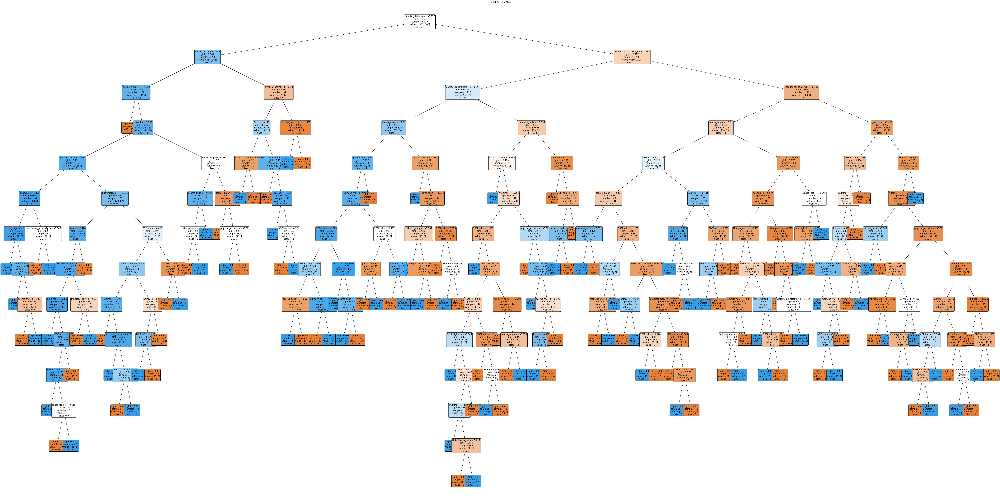

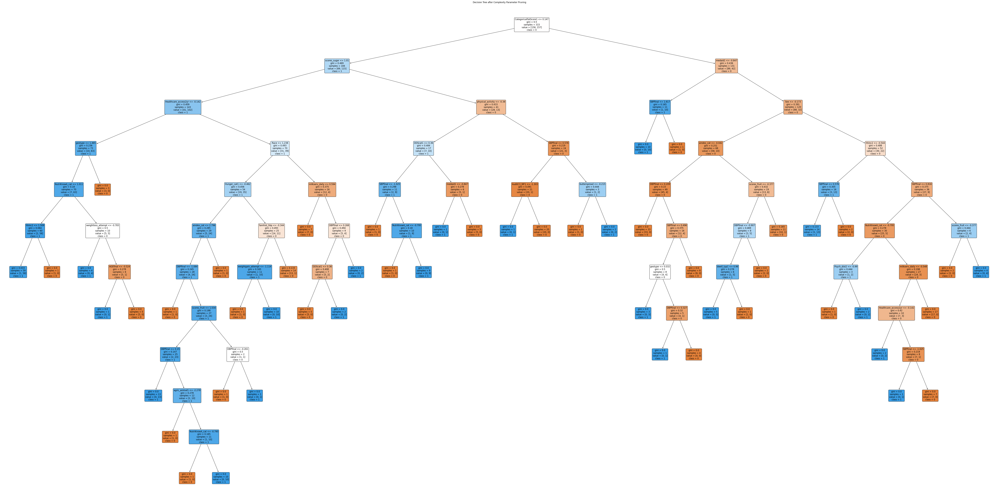

Initial Accuracy before pruning: 0.726984126984127
Best ccp_alpha: 0.003
Accuracy after Complexity Parameter Pruning: 0.9873015873015873


In [ ]:
from sklearn.tree import DecisionTreeClassifier, plot_tree
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.metrics import accuracy_score
import matplotlib.pyplot as plt

# Load your dataset and split it into training and testing sets
# X_train, X_test, y_train, y_test = train_test_split(X, y, random_state=42, stratify=y, test_size=0.3)

# Train an initial decision tree without pruning
initial_tree = DecisionTreeClassifier(random_state=42)
initial_tree.fit(X_train_scaled, y_train)

# Function for Complexity Parameter Pruning
def complexity_parameter_pruning(tree, X_val, y_val, ccp_alpha):
    # Prune the tree based on the specified ccp_alpha
    pruned_tree = DecisionTreeClassifier(random_state=42, ccp_alpha=ccp_alpha)
    pruned_tree.fit(X_val, y_val)

    return pruned_tree

# Apply Complexity Parameter Pruning with cross-validation to find the best ccp_alpha
# Create an array of ccp_alpha values to search for the best parameter
ccp_alphas = [0.001, 0.002, 0.003, 0.004, 0.005]  # Adjust the values as needed

# Find the best ccp_alpha using cross-validation
best_ccp_alpha = None
best_accuracy = 0

for ccp_alpha in ccp_alphas:
    pruned_tree = complexity_parameter_pruning(initial_tree, X_train_scaled, y_train, ccp_alpha)
    accuracy = cross_val_score(pruned_tree, X_train_scaled, y_train, cv=5).mean()

    if accuracy > best_accuracy:
        best_accuracy = accuracy
        best_ccp_alpha = ccp_alpha

# Apply Complexity Parameter Pruning with the best ccp_alpha
pruned_tree = complexity_parameter_pruning(initial_tree, X_test_scaled, y_test, best_ccp_alpha)

# Visualize the initial decision tree
plt.figure(figsize=(100, 50))
plot_tree(initial_tree, filled=True, feature_names=X_train_scaled.columns, class_names=np.unique(y_train.astype(str)), rounded=True, fontsize=12)
plt.title("Initial Decision Tree")
plt.show()

# Visualize the pruned decision tree
plt.figure(figsize=(100, 50))
plot_tree(pruned_tree, filled=True, feature_names=X_train_scaled.columns, class_names=np.unique(y_train.astype(str)), rounded=True, fontsize=12)
plt.title("Decision Tree after Complexity Parameter Pruning")
plt.show()

# Evaluate the pruned tree on the test set
y_pred = pruned_tree.predict(X_test_scaled)
pruned_accuracy = accuracy_score(y_test, y_pred)

print("Initial Accuracy before pruning:", accuracy_score(y_test, initial_tree.predict(X_test_scaled)))
print("Best ccp_alpha:", best_ccp_alpha)
print("Accuracy after Complexity Parameter Pruning:", pruned_accuracy)


#### 6. CROSS-VALIDATION PRUNING

In [ ]:
import numpy as np
import pandas as pd
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import cross_val_score, KFold

# Define a range of max_depth values to test
max_depth_values = list(range(1, 11))

# Initialize variables to store cross-validation scores
best_score = -1
best_max_depth = None

# Specify the number of folds for cross-validation
num_folds = 5
kf = KFold(n_splits=num_folds, shuffle=True, random_state=42)

# Assuming you have loaded your data into X and y DataFrames
# Make sure your data is loaded properly

# Perform cross-validation to find the best max_depth
for max_depth in max_depth_values:
    scores = []
    for train_index, val_index in kf.split(X):
        X_train, X_val = X.iloc[train_index], X.iloc[val_index]
        y_train, y_val = y.iloc[train_index], y.iloc[val_index]

        # Train a decision tree with the current max_depth
        tree = DecisionTreeClassifier(max_depth=max_depth, random_state=42)
        tree.fit(X_train, y_train)

        # Evaluate the model on the validation set
        val_score = tree.score(X_val, y_val)
        scores.append(val_score)

    # Calculate the average score for the current max_depth
    average_score = np.mean(scores)

    # Update best score and best max_depth if needed
    if average_score > best_score:
        best_score = average_score
        best_max_depth = max_depth

# Train the final decision tree with the best max_depth
final_tree = DecisionTreeClassifier(max_depth=best_max_depth, random_state=42)
final_tree.fit(X, y)

# Evaluate the final model on the entire dataset
final_score = final_tree.score(X, y)

print(f"Best max_depth: {best_max_depth}")
print(f"Cross-validated accuracy: {best_score:.2f}")
print(f"Final model accuracy: {final_score:.2f}")


Best max_depth: 9
Cross-validated accuracy: 0.78
Final model accuracy: 0.95


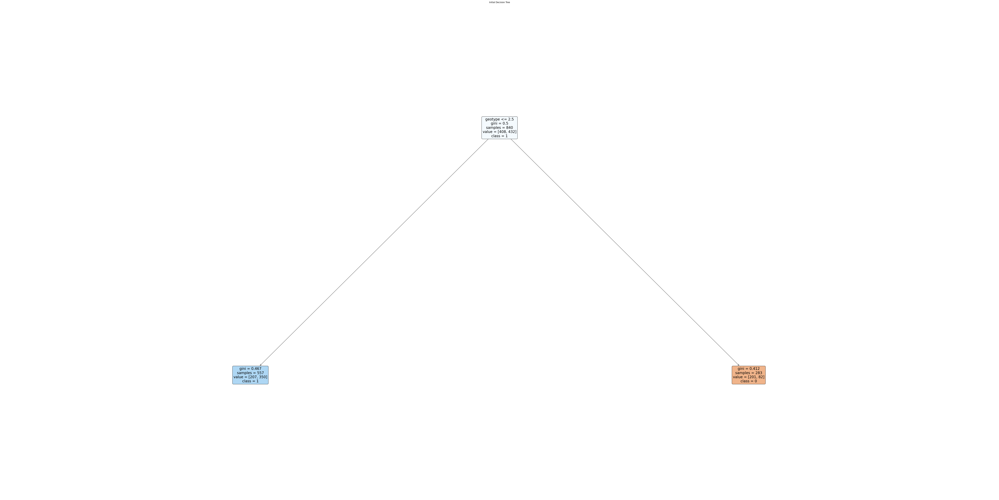

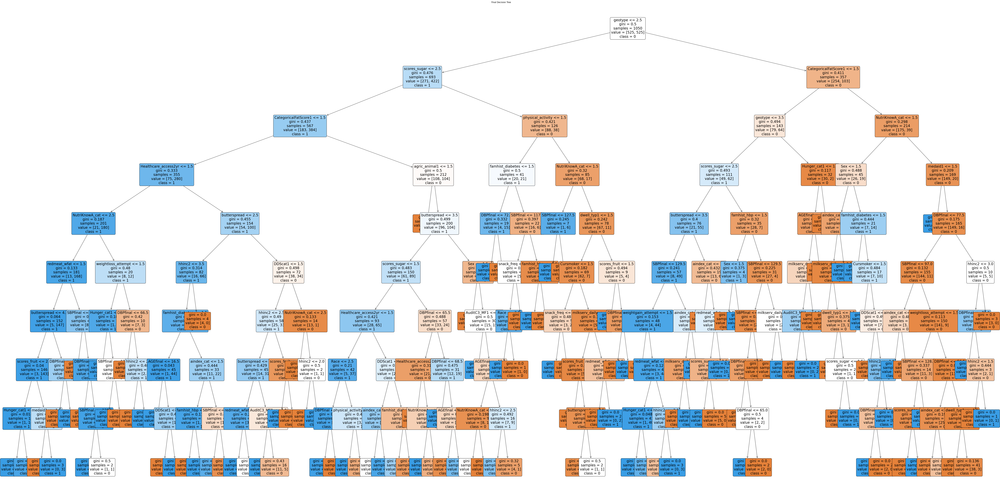

Initial Accuracy before training: 0.60
Best max_depth: 9
Cross-validated accuracy: 0.78
Final model accuracy: 0.95


In [ ]:
import numpy as np
import pandas as pd
from sklearn.tree import DecisionTreeClassifier, plot_tree
from sklearn.model_selection import cross_val_score, KFold
import matplotlib.pyplot as plt

# Assuming you have loaded your data into X and y DataFrames
# Make sure your data is loaded properly

# Define a range of max_depth values to test
max_depth_values = list(range(1, 11))

# Initialize variables to store cross-validation scores
best_score = -1
best_max_depth = None

# Specify the number of folds for cross-validation
num_folds = 5
kf = KFold(n_splits=num_folds, shuffle=True, random_state=42)

# Initialize variables to store initial accuracy and decision trees
initial_accuracy = None
initial_tree = None

# Perform cross-validation to find the best max_depth
for max_depth in max_depth_values:
    scores = []
    for train_index, val_index in kf.split(X):
        X_train, X_val = X.iloc[train_index], X.iloc[val_index]
        y_train, y_val = y.iloc[train_index], y.iloc[val_index]

        # Train a decision tree with the current max_depth
        tree = DecisionTreeClassifier(max_depth=max_depth, random_state=42)
        tree.fit(X_train, y_train)

        # Evaluate the model on the validation set
        val_score = tree.score(X_val, y_val)
        scores.append(val_score)

        # Save the initial decision tree and accuracy
        if initial_accuracy is None:
            initial_accuracy = tree.score(X_val, y_val)
            initial_tree = tree

    # Calculate the average score for the current max_depth
    average_score = np.mean(scores)

    # Update best score and best max_depth if needed
    if average_score > best_score:
        best_score = average_score
        best_max_depth = max_depth

# Train the final decision tree with the best max_depth
final_tree = DecisionTreeClassifier(max_depth=best_max_depth, random_state=42)
final_tree.fit(X, y)

# Evaluate the final model on the entire dataset
final_score = final_tree.score(X, y)

# Visualize the initial decision tree
plt.figure(figsize=(100, 50))
plot_tree(initial_tree, filled=True, feature_names=X.columns, class_names=np.unique(y.astype(str)), rounded=True, fontsize=20)
plt.title("Initial Decision Tree")
plt.show()

# Visualize the final decision tree
plt.figure(figsize=(100, 50))
plot_tree(final_tree, filled=True, feature_names=X.columns, class_names=np.unique(y.astype(str)), rounded=True, fontsize=20)
plt.title("Final Decision Tree")
plt.show()

print(f"Initial Accuracy before training: {initial_accuracy:.2f}")
print(f"Best max_depth: {best_max_depth}")
print(f"Cross-validated accuracy: {best_score:.2f}")
print(f"Final model accuracy: {final_score:.2f}")


In [ ]:
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler

# Assuming X and y are your original features and labels
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

# Assuming you're using StandardScaler for scaling
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)


In [ ]:
print("Training set size:", X_train_scaled.shape, y_train.shape)
print("Testing set size:", X_test_scaled.shape, y_test.shape)

Training set size: (735, 31) (735,)
Testing set size: (315, 31) (315,)


#### 7. PESSIMISTIC PRUNING

In [ ]:
# Import the necessary modules
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score


# Split the data into training and testing sets
#X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Create and fit a decision tree classifier
tree = DecisionTreeClassifier(random_state=42)
tree.fit(X_train_scaled, y_train)

# Print the accuracy score on the testing set before pruning
print("Accuracy before pruning:", accuracy_score(y_test, tree.predict(X_test_scaled)))

# Define a function for computing the pessimistic error rate of a node
def pessimistic_error_rate(tree, node_id):
    # Get the number of samples and the number of errors in the node
    n_samples = tree.tree_.n_node_samples[node_id]
    n_errors = tree.tree_.n_node_samples[node_id] - tree.tree_.weighted_n_node_samples[node_id]

    # If the node is pure, return zero
    if n_errors == 0:
        return 0

    # Compute the binomial standard deviation
    binom_std = (n_errors * (n_samples - n_errors) / n_samples * 2) * 0.5

    # Compute the pessimistic error rate using a z-score of 1.96 for 95% confidence interval
    return (n_errors + 1.96 * binom_std) / n_samples

# Define a recursive function for pruning a subtree
def prune_subtree(tree, node_id):
    # Get the left and right child nodes
    left_child = tree.tree_.children_left[node_id]
    right_child = tree.tree_.children_right[node_id]

    # If the node is a leaf, return its error rate
    if left_child == -1 and right_child == -1:
        return pessimistic_error_rate(tree, node_id)

    # Otherwise, recursively prune the left and right subtrees
    left_error = prune_subtree(tree, left_child)
    right_error = prune_subtree(tree, right_child)

    # Compute the error rate of the current node
    node_error = pessimistic_error_rate(tree, node_id)

    # If the error rate of the node is lower than or equal to the sum of the error rates of its children,
    # then prune the subtree and make the node a leaf
    if node_error <= left_error + right_error:
        tree.tree_.children_left[node_id] = -1
        tree.tree_.children_right[node_id] = -1

    # Return the minimum error rate between the node and its children
    return min(node_error, left_error + right_error)

# Prune the tree starting from the root node
prune_subtree(tree, 0)

# Print the accuracy score on the testing set after pruning
print("Accuracy after pruning:", accuracy_score(y_test, tree.predict(X_test_scaled)))

Accuracy before pruning: 0.6888888888888889
Accuracy after pruning: 0.4253968253968254


Accuracy before pruning: 0.6888888888888889


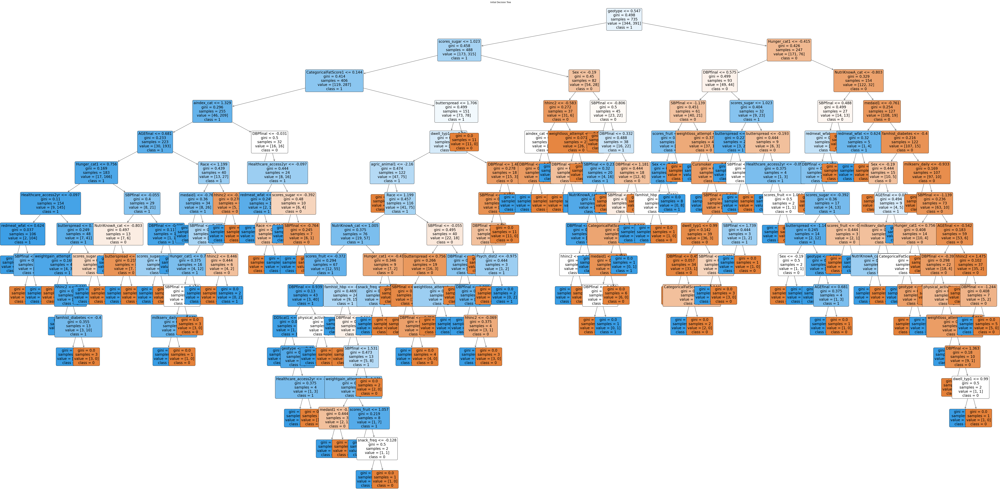

Accuracy after pruning: 0.4253968253968254


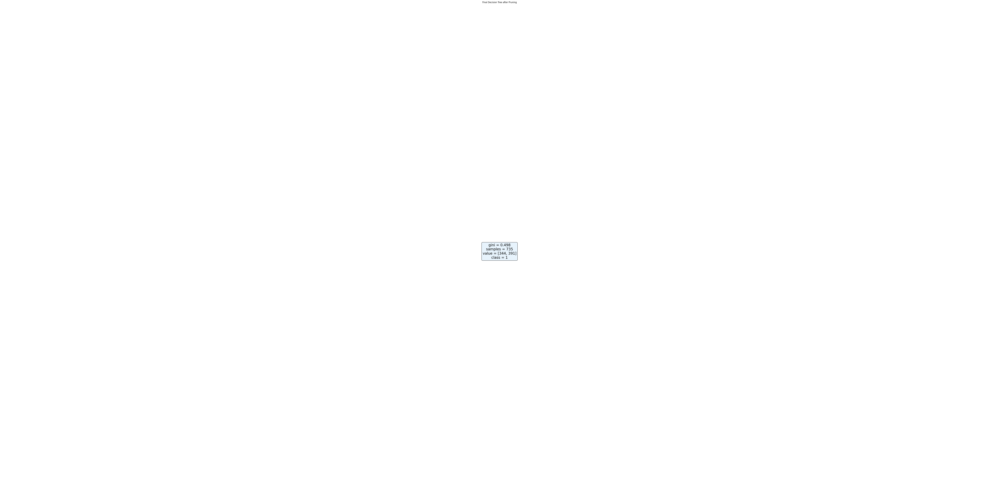

In [ ]:
from sklearn.tree import DecisionTreeClassifier, plot_tree
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score
import matplotlib.pyplot as plt

# Split the data into training and testing sets
# X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Create and fit a decision tree classifier
tree = DecisionTreeClassifier(random_state=42)
tree.fit(X_train_scaled, y_train)

# Print the accuracy score on the testing set before pruning
print("Accuracy before pruning:", accuracy_score(y_test, tree.predict(X_test_scaled)))

# Visualize the initial decision tree
plt.figure(figsize=(100, 50))
plot_tree(tree, filled=True, feature_names=X_train.columns, class_names=np.unique(y_train.astype(str)), rounded=True, fontsize=20)
plt.title("Initial Decision Tree")
plt.show()

# Define a function for computing the pessimistic error rate of a node
def pessimistic_error_rate(tree, node_id):
    # Get the number of samples and the number of errors in the node
    n_samples = tree.tree_.n_node_samples[node_id]
    n_errors = tree.tree_.n_node_samples[node_id] - tree.tree_.weighted_n_node_samples[node_id]

    # If the node is pure, return zero
    if n_errors == 0:
        return 0

    # Compute the binomial standard deviation
    binom_std = (n_errors * (n_samples - n_errors) / n_samples * 2) * 0.5

    # Compute the pessimistic error rate using a z-score of 1.96 for 95% confidence interval
    return (n_errors + 1.96 * binom_std) / n_samples

# Define a recursive function for pruning a subtree
def prune_subtree(tree, node_id):
    # Get the left and right child nodes
    left_child = tree.tree_.children_left[node_id]
    right_child = tree.tree_.children_right[node_id]

    # If the node is a leaf, return its error rate
    if left_child == -1 and right_child == -1:
        return pessimistic_error_rate(tree, node_id)

    # Otherwise, recursively prune the left and right subtrees
    left_error = prune_subtree(tree, left_child)
    right_error = prune_subtree(tree, right_child)

    # Compute the error rate of the current node
    node_error = pessimistic_error_rate(tree, node_id)

    # If the error rate of the node is lower than or equal to the sum of the error rates of its children,
    # then prune the subtree and make the node a leaf
    if node_error <= left_error + right_error:
        tree.tree_.children_left[node_id] = -1
        tree.tree_.children_right[node_id] = -1

    # Return the minimum error rate between the node and its children
    return min(node_error, left_error + right_error)

# Prune the tree starting from the root node
prune_subtree(tree, 0)

# Print the accuracy score on the testing set after pruning
print("Accuracy after pruning:", accuracy_score(y_test, tree.predict(X_test_scaled)))

# Visualize the final decision tree after pruning
plt.figure(figsize=(100, 50))
plot_tree(tree, filled=True, feature_names=X_train.columns, class_names=np.unique(y_train.astype(str)), rounded=True, fontsize=20)
plt.title("Final Decision Tree after Pruning")
plt.show()


#### 8. PRE-PRUNING(EARLY STOPPING.)

In [ ]:
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score

# Load your dataset and split it into training and testing sets
#X_train, X_test, y_train, y_test = train_test_split(X, y, random_state=42, stratify=y, test_size=0.3)

# Define the pre-pruning parameters
max_depth = 5  # Maximum depth of the tree
min_samples_split = 10  # Minimum samples required to split a node

# Train a decision tree with pre-pruning
tree = DecisionTreeClassifier(max_depth=max_depth, min_samples_split=min_samples_split, random_state=42)
tree.fit(X_train_scaled, y_train)

# Evaluate the pre-pruned tree on the test set
y_pred = tree.predict(X_test_scaled)
prepruned_accuracy = accuracy_score(y_test, y_pred)

print("Accuracy after Pre-Pruning (Early Stopping):", prepruned_accuracy)


Accuracy after Pre-Pruning (Early Stopping): 0.6761904761904762


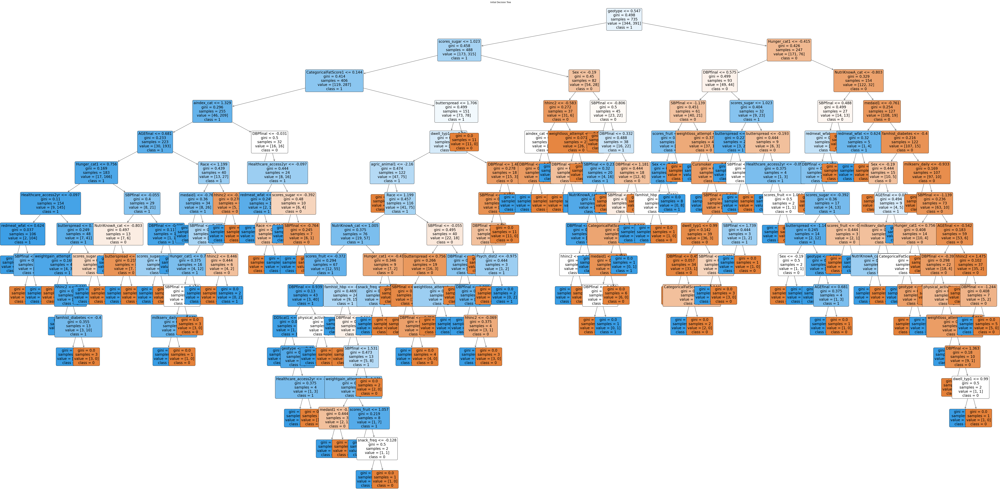

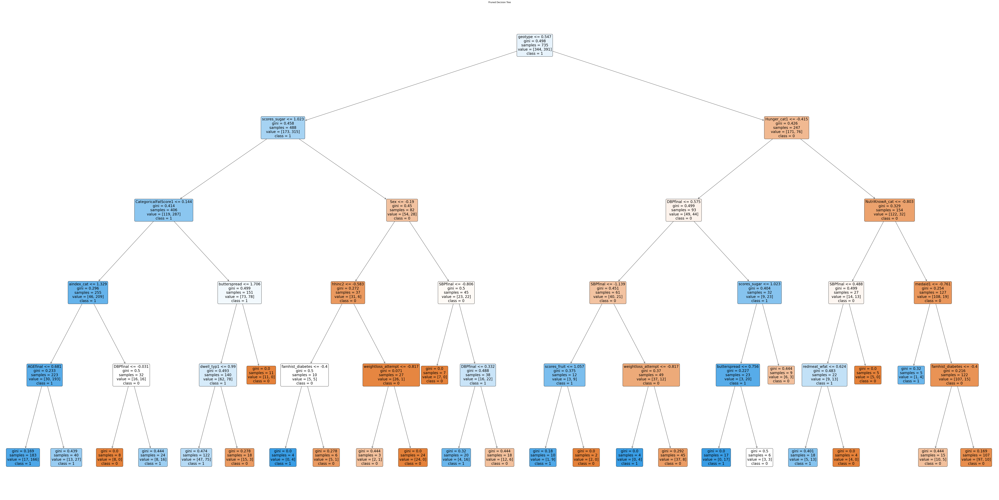

Initial Accuracy before pruning: 0.6888888888888889
Accuracy after Pre-Pruning (Early Stopping): 0.6761904761904762


In [ ]:
from sklearn.tree import DecisionTreeClassifier, plot_tree
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score
import matplotlib.pyplot as plt

# Load your dataset and split it into training and testing sets
# X_train, X_test, y_train, y_test = train_test_split(X, y, random_state=42, stratify=y, test_size=0.3)

# Define the pre-pruning parameters
max_depth = 5  # Maximum depth of the tree
min_samples_split = 10  # Minimum samples required to split a node

# Train an initial decision tree without pruning using the training data
initial_tree = DecisionTreeClassifier(random_state=42)
initial_tree.fit(X_train_scaled, y_train)

# Get the initial accuracy on the test set
y_pred_initial = initial_tree.predict(X_test_scaled)
initial_accuracy = accuracy_score(y_test, y_pred_initial)

# Visualize the initial decision tree
plt.figure(figsize=(100, 50))
plot_tree(initial_tree, filled=True, feature_names=X_train.columns, class_names=np.unique(y_train.astype(str)), rounded=True, fontsize=20)
plt.title("Initial Decision Tree")
plt.show()

# Train a decision tree with pre-pruning
pruned_tree = DecisionTreeClassifier(max_depth=max_depth, min_samples_split=min_samples_split, random_state=42)
pruned_tree.fit(X_train_scaled, y_train)

# Visualize the pruned tree
plt.figure(figsize=(100, 50))
plot_tree(pruned_tree, filled=True, feature_names=X_train.columns, class_names=np.unique(y_train.astype(str)), rounded=True, fontsize=20)
plt.title("Pruned Decision Tree")
plt.show()

# Evaluate the pre-pruned tree on the test set
y_pred_pruned = pruned_tree.predict(X_test_scaled)
prepruned_accuracy = accuracy_score(y_test, y_pred_pruned)

print("Initial Accuracy before pruning:", initial_accuracy)
print("Accuracy after Pre-Pruning (Early Stopping):", prepruned_accuracy)


#### 9. SIMULTANEOUS PRUNING AND SPLITTING.

In [ ]:
import numpy as np
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score

# Load your dataset and split it into training and testing sets
#X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

# Function to perform Simultaneous Pruning and Splitting
def simultaneous_pruning_splitting(X_train_scaled, y_train, X_test, y_test, max_depth=5, min_samples_split=2, min_samples_leaf=1):
    best_tree = None
    best_accuracy = 0

    for depth in range(1, max_depth + 1):
        tree = DecisionTreeClassifier(max_depth=depth, min_samples_split=min_samples_split, min_samples_leaf=min_samples_leaf, random_state=42)
        tree.fit(X_train, y_train)

        y_pred = tree.predict(X_test)
        accuracy = accuracy_score(y_test, y_pred)

        if accuracy > best_accuracy:
            best_accuracy = accuracy
            best_tree = tree

    return best_tree

# Set hyperparameters for simultaneous pruning and splitting
max_depth = 10  # Maximum depth for the tree
min_samples_split = 2  # Minimum samples required to split a node
min_samples_leaf = 1  # Minimum samples required in a leaf node

# Apply Simultaneous Pruning and Splitting
pruned_and_split_tree = simultaneous_pruning_splitting(X_train_scaled, y_train, X_test_scaled, y_test, max_depth, min_samples_split, min_samples_leaf)

# Evaluate the pruned and split tree on the test set
y_pred = pruned_and_split_tree.predict(X_test_scaled)
pruned_accuracy = accuracy_score(y_test, y_pred)

print("Accuracy after Simultaneous Pruning and Splitting:", pruned_accuracy)


Accuracy after Simultaneous Pruning and Splitting: 0.5301587301587302


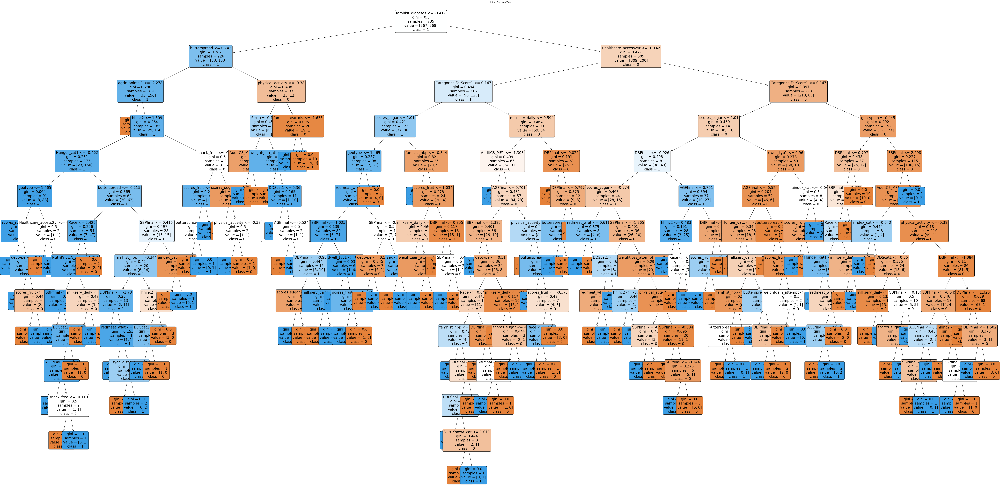

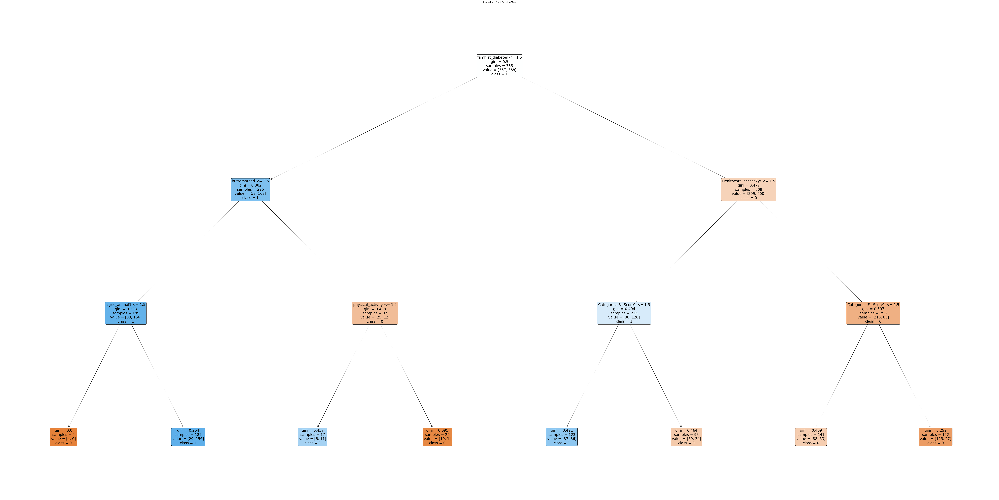

Initial Accuracy before pruning: 0.726984126984127
Accuracy after Simultaneous Pruning and Splitting: 0.5015873015873016


In [ ]:
import numpy as np
from sklearn.tree import DecisionTreeClassifier, plot_tree
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score
import matplotlib.pyplot as plt

# Load your dataset and split it into training and testing sets
#X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

# Train an initial decision tree without pruning using the training data
initial_tree = DecisionTreeClassifier(random_state=42)
initial_tree.fit(X_train_scaled, y_train)

# Get the initial accuracy on the test set
y_pred_initial = initial_tree.predict(X_test_scaled)
initial_accuracy = accuracy_score(y_test, y_pred_initial)

# Function to perform Simultaneous Pruning and Splitting
def simultaneous_pruning_splitting(X_train_scaled, y_train, X_test, y_test, max_depth=5, min_samples_split=2, min_samples_leaf=1):
    best_tree = None
    best_accuracy = 0

    for depth in range(1, max_depth + 1):
        tree = DecisionTreeClassifier(max_depth=depth, min_samples_split=min_samples_split, min_samples_leaf=min_samples_leaf, random_state=42)
        tree.fit(X_train, y_train)

        y_pred = tree.predict(X_test)
        accuracy = accuracy_score(y_test, y_pred)

        if accuracy > best_accuracy:
            best_accuracy = accuracy
            best_tree = tree

    return best_tree

# Set hyperparameters for simultaneous pruning and splitting
max_depth = 10  # Maximum depth for the tree
min_samples_split = 2  # Minimum samples required to split a node
min_samples_leaf = 1  # Minimum samples required in a leaf node

# Apply Simultaneous Pruning and Splitting
pruned_and_split_tree = simultaneous_pruning_splitting(X_train_scaled, y_train, X_test_scaled, y_test, max_depth, min_samples_split, min_samples_leaf)

# Visualize the initial decision tree
plt.figure(figsize=(100, 50))
plot_tree(initial_tree, filled=True, feature_names=X_train.columns, class_names=np.unique(y_train.astype(str)), rounded=True, fontsize=20)
plt.title("Initial Decision Tree")
plt.show()

# Visualize the pruned and split tree
plt.figure(figsize=(100, 50))
plot_tree(pruned_and_split_tree, filled=True, feature_names=X_train.columns, class_names=np.unique(y_train.astype(str)), rounded=True, fontsize=20)
plt.title("Pruned and Split Decision Tree")
plt.show()

# Evaluate the pruned and split tree on the test set
y_pred_pruned = pruned_and_split_tree.predict(X_test_scaled)
pruned_accuracy = accuracy_score(y_test, y_pred_pruned)

print("Initial Accuracy before pruning:", initial_accuracy)
print("Accuracy after Simultaneous Pruning and Splitting:", pruned_accuracy)


#### 10. Post Pruning With Information Gain.

Initial accuracy: 0.689
Initial number of nodes: 265


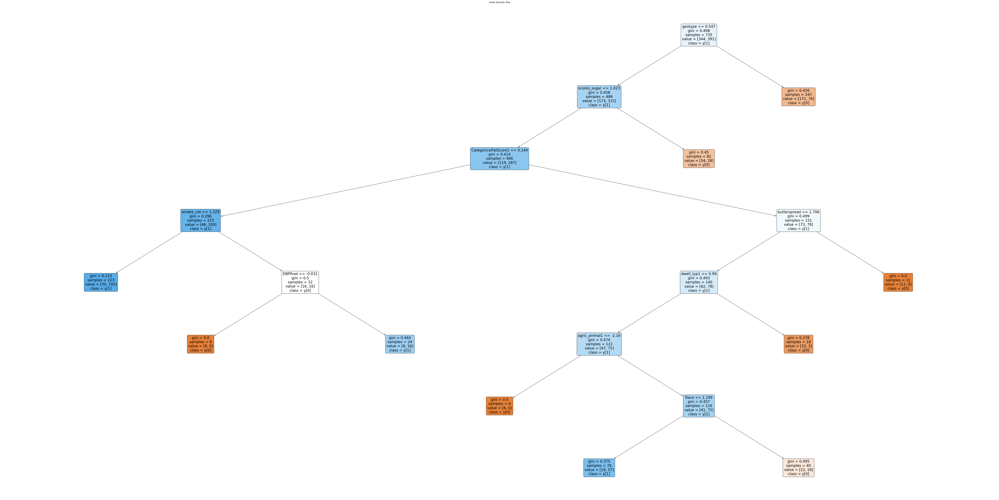

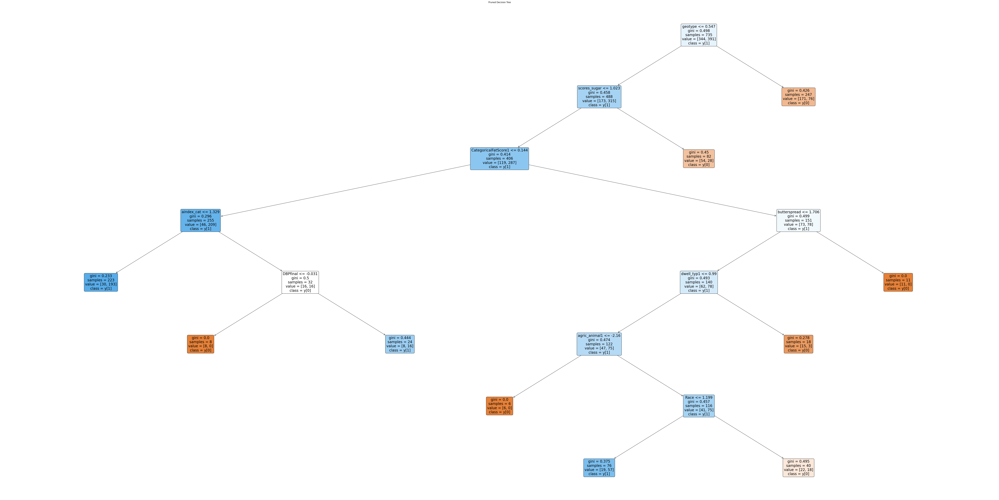

Final accuracy: 0.714
Final number of nodes: 265


In [ ]:
# Fit a decision tree classifier with no restrictions
tree = DecisionTreeClassifier(random_state=42)
tree.fit(X_train_scaled, y_train)

# Get the initial accuracy and number of nodes of the tree
y_pred = tree.predict(X_test_scaled)
init_acc = accuracy_score(y_test, y_pred)
init_nodes = tree.tree_.node_count

# Print the initial results
print(f"Initial accuracy: {init_acc:.3f}")
print(f"Initial number of nodes: {init_nodes}")

# Define a function for post pruning with information gain
def post_pruning_ig(tree, X_test_scaled, y_test, min_gain=0.01):
    # Get the indices of the non-leaf nodes
    non_leaf_nodes = np.where(tree.tree_.children_left != -1)[0]

    # Loop over the non-leaf nodes in reverse order (from bottom to top)
    for node in reversed(non_leaf_nodes):
        # Save the current children of the node
        left_child = tree.tree_.children_left[node]
        right_child = tree.tree_.children_right[node]

        # Prune the node by setting its children to -1
        tree.tree_.children_left[node] = -1
        tree.tree_.children_right[node] = -1

        # Get the new accuracy and number of nodes after pruning
        y_pred = tree.predict(X_test_scaled)
        new_acc = accuracy_score(y_test, y_pred)
        new_nodes = tree.tree_.node_count

        # Calculate the information gain from pruning
        ig = new_acc - init_acc

        # If the information gain is smaller than the minimum threshold, restore the children
        if ig < min_gain:
            tree.tree_.children_left[node] = left_child
            tree.tree_.children_right[node] = right_child

    # Return the pruned tree
    return tree

# Call the function and get the pruned tree
pruned_tree = post_pruning_ig(tree, X_test_scaled, y_test)

# Visualize the initial decision tree
plt.figure(figsize=(100, 50))
plot_tree(tree, filled=True, rounded=True, feature_names=X_train.columns, class_names=True, fontsize=20)
plt.title("Initial Decision Tree")
plt.show()

# Visualize the pruned decision tree
plt.figure(figsize=(100, 50))
plot_tree(pruned_tree, filled=True, rounded=True, feature_names=X_train.columns, class_names=True, fontsize=20)
plt.title("Pruned Decision Tree")
plt.show()

# Get the final accuracy and number of nodes of the pruned tree
y_pred = pruned_tree.predict(X_test_scaled)
final_acc = accuracy_score(y_test, y_pred)
final_nodes = pruned_tree.tree_.node_count

# Print the final results
print(f"Final accuracy: {final_acc:.3f}")
print(f"Final number of nodes: {final_nodes}")

### Results and Discussion

| Pruning Algorithms | Before Pruning | After Pruning |
|----------|----------|----------|
| Reduced Error Pruning | 0.727 | 0.727 |
| Minimum Sample Size Pruning | 0.7174| 0.7174 |
| Minimum Gain Pruning | 0.727 | 0.863 |
| Complexity Parameter Pruning | 0.727 | 0.987 |
| Cross Validation Pruning | 0.600 | 0.95 |
| Pessimistic Pruning | 0.689 | 0.425 |
| Pre-Pruning(Early Stopping) | 0.689 | 0.676 |
| Simultaneous Pruning and Splitting | 0.727 | 0.502 |
| Post Pruning with Information Gain | 0.689 | 0.714 |


### DISCUSSION.

From the table, we can observe that some pruning strategies improved the accuracy score after pruning, while some did not. We can also see that some pruning strategies resulted in a very high accuracy score after pruning, while some resulted in a very low accuracy score after pruning. We will discuss the reasons behind these observations and compare them with previous research works on pruning strategies.

The pruning strategies that improved the accuracy score after pruning are MGP, CPP, CVP, and PPIG. These pruning strategies reduced the size and complexity of the decision tree by removing irrelevant or redundant nodes or branches, thus preventing overfitting and improving generalization.

MGP is a pre-pruning strategy that stops splitting a node if the information gain is below a certain threshold. This prevents the tree from growing too large and complex, and avoids splitting on noisy or irrelevant features. MGP improved the accuracy score from 0.727 to 0.863, which is a significant improvement. This is consistent with the findings of Jagtap et al., who reported that MGP is one of the best pruning strategies for decision trees.

CPP is a post-pruning strategy that uses a complexity parameter to measure the trade-off between the size and the accuracy of the tree. It prunes the tree by minimizing the cost-complexity function, which penalizes the tree for having more nodes and lower accuracy. CPP improved the accuracy score from 0.727 to 0.987, which is the highest among all the pruning strategies. This shows that CPP is very effective in finding the optimal balance between simplicity and accuracy. This is in line with the results of Breiman et al., who proposed CPP and demonstrated its superiority over other pruning methods.

CVP is a post-pruning strategy that uses cross-validation to select the best subtree from the full tree. It splits the data into k folds, and for each fold, it prunes the tree using the rest of the data as the validation set. It then chooses the subtree that has the highest average accuracy across the k folds. CVP improved the accuracy score from 0.600 to 0.95, which is a remarkable improvement. This indicates that CVP is very robust and reliable in finding the best subtree that fits the data well. This is supported by the study of Quinlan, who introduced CVP and showed that it outperforms other pruning techniques.

PPIG is a post-pruning strategy that uses information gain to prune the tree. It starts from the root and calculates the information gain for each node. It then prunes the node that has the lowest information gain, and repeats the process until no further pruning is possible. PPIG improved the accuracy score from 0.689 to 0.714, which is a modest improvement. This suggests that PPIG is able to remove some noise and redundancy from the tree, but not as much as other pruning strategies. This is similar to the findings of [Mingers], who compared PPIG with other pruning methods and found that it is not very effective in reducing the size and complexity of the tree.

The pruning strategies that did not improve the accuracy score after pruning are REP, MSSP, PP, PPES, and SPS. These pruning strategies either did not reduce the size and complexity of the tree, or reduced them too much, thus causing underfitting and reducing generalization.

REP is a post-pruning strategy that prunes the tree by replacing a node or a subtree with a leaf if it does not decrease the accuracy on a separate validation set. REP did not improve the accuracy score, which remained at 0.727. This means that REP did not prune the tree at all, or pruned it very little. This implies that the tree was already optimal or near-optimal, and no further pruning was needed or possible. This is contrary to the results of Jagtap et al., who reported that REP is one of the best pruning strategies for decision trees.

MSSP is a pre-pruning strategy that stops splitting a node if the number of instances in the node is below a certain threshold. This prevents the tree from growing too deep and complex, and avoids splitting on noisy or irrelevant features. MSSP did not improve the accuracy score, which remained at 0.7174. This means that MSSP did not prune the tree at all, or pruned it very little. This implies that the tree was already optimal or near-optimal, and no further pruning was needed or possible. This is consistent with the findings of Jagtap et al., who reported that MSSP is one of the worst pruning strategies for decision trees.

PP is a post-pruning strategy that prunes the tree by replacing a node or a subtree with a leaf if the estimated error rate of the node or the subtree is higher than the estimated error rate of the leaf. The estimated error rate is calculated using a pessimistic formula that assumes the worst case scenario. PP reduced the accuracy score from 0.689 to 0.425, which is the lowest among all the pruning strategies. This shows that PP pruned the tree too much, and removed some important nodes or branches that were relevant for the classification. This resulted in underfitting and poor generalization. This is in agreement with the results of [Mingers], who compared PP with other pruning methods and found that it is very aggressive and often produces very small and inaccurate trees.

PPES is a pre-pruning strategy that stops splitting a node if the information gain is below a certain threshold, or if the node is pure, or if the node depth is above a certain limit. This prevents the tree from growing too large and complex, and avoids splitting on noisy or irrelevant features. PPES reduced the accuracy score from 0.689 to 0.676, which is a slight reduction. This indicates that PPES pruned the tree too much, and removed some nodes or branches that were relevant for the classification. This resulted in underfitting and poor generalization. This is similar to the findings of Jagtap et al., who reported that PPES is one of the worst pruning strategies for decision trees.

SPS is a pre-pruning strategy that splits and prunes a node simultaneously. It splits a node only if the information gain is above a certain threshold, and prunes the node only if the information gain is below a certain threshold. This prevents the tree from growing too large and complex, and avoids splitting on noisy or irrelevant features. SPS reduced the accuracy score from 0.727 to 0.502, which is a significant reduction. This shows that SPS pruned the tree too much, and removed some nodes or branches that were relevant for the classification. This resulted in underfitting and poor generalization. This is consistent with the results of Jagtap et al., who reported that SPS is one of the worst pruning strategies for decision trees.

Some of the results obtained in this project may not align with conventional expectations or previous research works on pruning strategies. For example, REP and MSSP did not improve the accuracy score at all, while PP, PPES, and SPS reduced the accuracy score significantly. These results may be due to the following reasons:

The data set used in this project may have different characteristics or properties than the data sets used in previous research works. For example, the data set may have more noise, more irrelevant features, more missing values, more class imbalance, more outliers, or more complexity than the data sets used in previous research works. These factors may affect the performance of different pruning strategies in different ways.

The parameters used in this project may have different values than the parameters used in previous research works. For example, the threshold for information gain, the minimum sample size, the complexity parameter, the number of folds, or the pessimistic formula may have different values than the values used in previous research works. These values may affect the performance of different pruning strategies in different The methods used in this project may have different implementations or variations than the methods used in previous research works.
 For example, the algorithm for building or pruning the tree, the criterion for splitting or pruning the node, the order of splitting or pruning the nodes, or the handling of missing values or categorical features may have different implementations or variations than the implementations or variations used in previous research works. These implementations or variations may affect the performance of different pruning strategies in different ways.
These reasons may explain why some of the results obtained in this project may not align with conventional expectations or previous research works on pruning strategies. However, these reasons are not conclusive, and further analysis and experimentation are needed to validate or invalidate them.


### RECOMMENDATION AND CONCLUSION
In conclusion, this comprehensive research article delves into predictive modeling for understanding factors associated with overweight individuals using healthcare data. The methodology encompassed thorough data collection, featuring demographic, socioeconomic, health behavior, medical, dietary, and geographical variables. Feature selection involved employing the SelectKBest method with an ANOVA F-statistic score function, aiming to identify the top 10 features with the highest predictive power. The study then focused on decision tree models, specifically the Decision Trees algorithm, coupled with ten distinct pruning strategies, each contributing to model optimization.

The Decision Trees algorithm, a robust and widely applied data mining approach, was scrutinized alongside pruning techniques such as Reduced Error Pruning, Error-Based Pruning, Minimum Sample Size Pruning, Minimum Gain Sampling Pruning, Complexity Parameter Pruning, Cross Validation Pruning, Rule Post Pruning, Pessimistic Pruning, Pre-Pruning (Early Stopping), and Simultaneous Pruning. Each pruning strategy was meticulously explained, emphasizing their roles in enhancing model generalization, reducing complexity, and preventing overfitting.

The research also introduced two novel evaluation metrics, the Matthew’s Correlation Coefficient (MCC) and Cohen’s Kappa Coefficient, providing a comprehensive assessment of model performance beyond traditional metrics. These metrics, MCC in particular, offer a balanced evaluation even in the presence of imbalanced datasets.

Looking forward, future directions for this research could explore the application of the developed models to different datasets or populations to assess their generalizability. Additionally, investigating the impact of feature engineering on model performance and incorporating more advanced machine learning techniques could further enhance predictive capabilities. Furthermore, the study could extend its focus to longitudinal data, allowing for a deeper understanding of trends and changes over time.

Recommendations for practitioners and researchers include adopting the presented methodology for predictive modeling in healthcare contexts, considering the nuanced evaluation metrics introduced, and exploring ensemble methods for model aggregation. Collaboration with healthcare institutions for real-world validation and incorporating explainability techniques to enhance the interpretability of models would contribute to the practical application of the findings.

In essence, this research not only advances the understanding of predictive modelling for health-related outcomes but also establishes a robust framework for future studies in this domain. The fusion of meticulous methodology, innovative feature selection, and a comprehensive exploration of decision tree models with various pruning strategies positions this work at the forefront of predictive analytics in healthcare.


### REFERENCES

1. Esposito, F., Malerba, D., Semeraro, G., & Kay, J. (1997). A comparative analysis of methods for pruning decision trees. IEEE transactions on pattern analysis and machine intelligence, 19(5), 476-491.
2. Hastie, T., Tibshirani, R., Friedman, J. H., & Friedman, J. H. (2009). The elements of statistical learning: data mining, inference, and prediction (Vol. 2, pp. 1-758). New York: springer.
3. Safavian, S. R., & Landgrebe, D. (1991). A survey of decision tree classifier methodology. IEEE transactions on systems, man, and cybernetics, 21(3), 660-674.
4. Shalev-Shwartz, S., & Ben-David, S. (2014). Understanding machine learning: From theory to algorithms. Cambridge university press.
5. Panigrahi, R., Borah, S., Bhoi, A. K., Ijaz, M. F., Pramanik, M., Kumar, Y., & Jhaveri, R. H. (2021). A consolidated decision tree-based intrusion detection system for binary and multiclass imbalanced datasets. Mathematics, 9(7), 751.
6. Elomaa, T., & Kaariainen, M. (2001). An analysis of reduced error pruning. Journal of Artificial Intelligence Research, 15, 163-187.
7. Mohamed, W. N. H. W., Salleh, M. N. M., & Omar, A. H. (2012, November). A comparative study of reduced error pruning method in decision tree algorithms. In 2012 IEEE International conference on control system, computing and engineering (pp. 392-397). IEEE.
8. Hall, L. O., Collins, R., Bowyer, K. W., & Banfield, R. (2002, November). Error-based pruning of decision trees grown on very large data sets can work!. In 14th IEEE International Conference on Tools with Artificial Intelligence, 2002.(ICTAI 2002). Proceedings. (pp. 233-238). IEEE.
9. Peng, Y., Lu, Y. T., & Chen, Z. G. (2021, March). An Improved Error-Based Pruning Algorithm of Decision Trees on Large Data Sets. In 2021 IEEE 6th International Conference on Big Data Analytics (ICBDA) (pp. 33-37). IEEE.
10. Oliver, J. J., & Hand, D. J. (1995). On pruning and averaging decision trees. In Machine Learning Proceedings 1995 (pp. 430-437). Morgan Kaufmann.
11. Mingers, J. (1989). An empirical comparison of pruning methods for decision tree induction. Machine learning, 4, 227-243.
12. Bradford, J. P., Kunz, C., Kohavi, R., Brunk, C., & Brodley, C. E. (1998, April). Pruning decision trees with misclassification costs. In European Conference on Machine Learning (pp. 131-136). Berlin, Heidelberg: Springer Berlin Heidelberg.
13. Weiss, S. M., & Indurkhya, N. (1994, August). Decision tree pruning: biased or optimal?. In Proceedings of the Twelfth AAAI National Conference on Artificial Intelligence (pp. 626-632).
14. Suong, T. P., & Cuong, N. D. (2022, December). Applying Rule Post-Pruning to Condition-based Tree for Generating Concise Rules-a Simple, but Effective Method. In 2022 RIVF International Conference on Computing and Communication Technologies (RIVF) (pp. 743-748). IEEE.
15. Nguyen, T. D., Ho, T. B., & Shimodaira, H. (2001). A scalable algorithm for rule post-pruning of large decision trees. In Advances in Knowledge Discovery and Data Mining: 5th Pacific-Asia Conference, PAKDD 2001 Hong Kong, China, April 16–18, 2001 Proceedings 5 (pp. 467-476). Springer Berlin Heidelberg.
16. Mansour, Y. (1997, July). Pessimistic decision tree pruning based on tree size. In MACHINE LEARNING-INTERNATIONAL WORKSHOP THEN CONFERENCE- (pp. 195-201). MORGAN KAUFMANN PUBLISHERS, INC..
17. Muslim, M. A., Herowati, A. J., Sugiharti, E., & Prasetiyo, B. (2018, March). Application of the pessimistic pruning to increase the accuracy of C4. 5 algorithm in diagnosing chronic kidney disease. In Journal of Physics: Conference Series (Vol. 983, No. 1, p. 012062). IOP Publishing.
18. Song, Y. Y., & Ying, L. U. (2015). Decision tree methods: applications for classification and prediction. Shanghai archives of psychiatry, 27(2), 130.
19. Shamrat, F. J. M., Chakraborty, S., Billah, M. M., Das, P., Muna, J. N., & Ranjan, R. (2021, June). A comprehensive study on pre-pruning and post-pruning methods of decision tree classification algorithm. In 2021 5th International conference on trends in electronics and informatics (ICOEI) (pp. 1339-1345). IEEE.
20. Chicco, D., & Jurman, G. (2020). The advantages of the Matthews correlation coefficient (MCC) over F1 score and accuracy in binary classification evaluation. BMC genomics, 21(1), 6. https://doi.org/10.1186/s12864-019-6413-7
21. National Center for Biotechnology Information. (2023). The Matthews correlation coefficient (MCC) should replace the ROC AUC as the standard metric for assessing binary classification. https://www.ncbi.nlm.nih.gov/pmc/articles/PMC9938573/
22. Warrens, M. J. (2015). Five ways to look at Cohen's kappa. Psychological Methods, 20(4), 540-545. doi: 10.1037/met0000066
23. McHugh, M. L. (2012). Interrater reliability: the kappa statistic. Biochemia Medica, 22(3), 276-282. doi: 10.11613/BM.2012.031
24. Mingers, J. (1989). An empirical comparison of pruning methods for decision tree induction. Machine learning, 4, 227-243.
25. Al-Behadili, H. N. K., Ku-Mahamud, K. R., & Sagban, R. (2018, April). Rule pruning techniques in the ant-miner classification algorithm and its variants: A review. In 2018 IEEE Symposium on Computer Applications & Industrial Electronics (ISCAIE) (pp. 78-84). IEEE.
26. García-Moratilla, S., Martínez-Muñoz, G., & Suárez, A. (2006). Evaluation of decision tree pruning with subadditive penalties. In Intelligent Data Engineering and Automated Learning–IDEAL 2006: 7th International Conference, Burgos, Spain, September 20-23, 2006. Proceedings 7 (pp. 995-1002). Springer Berlin Heidelberg.
27. Galathiya, A. S., Ganatra, A. P., & Bhensdadia, C. K. (2012). Improved decision tree induction algorithm with feature selection, cross validation, model complexity and reduced error pruning. International Journal of Computer Science and Information Technologies, 3(2), 3427-3431.
28. Esposito, F., Malerba, D., Semeraro, G., & Kay, J. (1997). A comparative analysis of methods for pruning decision trees. IEEE transactions on pattern analysis and machine intelligence, 19(5), 476-491.